In [1]:
%load_ext autoreload
%autoreload 2

# change directory to repo root, and verify
%cd '../'
!pwd

/cephyr/users/markpett/Alvis/satellite_poverty_prediction
/cephyr/users/markpett/Alvis/satellite_poverty_prediction


In [2]:
import matplotlib.pyplot as plt
from utils.geo_plot import setup_ax, plot_locs
from utils.plot import scatter_preds, to_gif
from utils.analysis import evaluate_df
from utils.names import rename_names, iso_a3_codes
from data_handling import create_full_tfrecords_paths

2023-01-24 11:59:36.215506: I tensorflow/stream_executor/platform/default/dso_loader.cc:54] Successfully opened dynamic library libcudart.so.11.0
2023-01-24 11:59:43.253722: I tensorflow/stream_executor/platform/default/dso_loader.cc:54] Successfully opened dynamic library libcuda.so.1
2023-01-24 11:59:43.437795: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1734] Found device 0 with properties: 
pciBusID: 0000:30:00.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.61GiB deviceMemoryBandwidth: 298.08GiB/s
2023-01-24 11:59:43.437936: I tensorflow/stream_executor/platform/default/dso_loader.cc:54] Successfully opened dynamic library libcudart.so.11.0
2023-01-24 11:59:43.931234: I tensorflow/stream_executor/platform/default/dso_loader.cc:54] Successfully opened dynamic library libcublas.so.11
2023-01-24 11:59:43.931481: I tensorflow/stream_executor/platform/default/dso_loader.cc:54] Successfully opened dynamic library libcublasLt.so.11
202

In [3]:
from collections import defaultdict
import itertools
import pickle
import os
import sys
import shutil

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import scipy
from matplotlib.pyplot import figure
from collections import defaultdict
from sklearn.linear_model import LinearRegression

In [4]:
data_dir = '/cephyr/NOBACKUP/groups/globalpoverty1/data/'
MIN_IWI = 0
MAX_IWI = 100
MODEL_NAMES = ['resnet', 'bidirectional_resnet_lstm', 'bidirectional_resnet_lstm_10']

df = pd.read_csv(os.path.join(data_dir, 'dhs_clusters.csv'), float_precision='high', index_col=False)
# get all tfrecords
tfrecord_files = np.asarray(create_full_tfrecords_paths(data_dir))
df['file'] = tfrecord_files
df['name'] = df['country'].apply(lambda x: rename_names[x])
df['iso_a3'] = df['country'].apply(lambda x: iso_a3_codes[x])
df['i'] = df['year'].apply(lambda x: (x-1990) // 3)

results_dict = {}
for fold_config in ['incountry', 'ooc', 'oots']:
    results_dict[fold_config] = {}
    for model_name in MODEL_NAMES:
        results_path = os.path.join(data_dir, 'results', fold_config, model_name + '.csv')
        results_df = pd.read_csv(results_path, float_precision='high', index_col=False)
        results_df = results_df.set_index('Unnamed: 0')
        # Rescale prediction values
        results_df.loc[:, results_df.columns != 'fold'] = (MAX_IWI - MIN_IWI) * results_df.loc[:, results_df.columns != 'fold'] + MIN_IWI
        results_df = df.merge(results_df, left_index=True, right_index=True)
        results_df['error'] = results_df.apply(lambda x: abs(x['iwi'] - x['y_i']), axis=1)
        results_dict[fold_config][model_name] = results_df

In [5]:
results_df

,country,survey_start_year,year,lat,lon,GID_1,GID_2,households,rural,iwi,...,y_3,y_4,y_5,y_6,y_7,y_8,y_9,y_i,fold,error
0,angola,2006,2006,-12.169283,13.859255,AGO.2,AGO.2.9,20,0,68.096300,...,10.528564,10.644531,9.265137,9.655762,11.761475,14.990234,17.614746,9.265137,B,58.831163
1,angola,2006,2006,-12.361700,14.778201,AGO.2,AGO.2.2,19,1,10.609053,...,17.578125,20.153809,22.180176,23.803711,27.612305,30.493164,32.861328,22.180176,B,11.571123
2,angola,2006,2006,-10.827451,14.342114,AGO.7,AGO.7.1,25,1,29.973928,...,17.883301,19.726562,20.031738,19.531250,21.777344,23.095703,25.561523,20.031738,B,9.942190
3,angola,2006,2006,-9.991311,14.898295,AGO.7,AGO.7.5,1,1,7.704135,...,18.591309,21.826172,24.987793,27.294922,30.371094,36.669922,38.574220,24.987793,B,17.283658
4,angola,2006,2006,-11.518893,14.750437,AGO.7,AGO.7.10,24,1,13.371826,...,12.573242,15.234375,13.964844,16.210938,18.945312,25.463867,30.346680,13.964844,B,0.593018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57190,zimbabwe,2015,2015,-20.911177,30.008579,ZWE.10,ZWE.10.6,28,1,27.791567,...,17.126465,16.577148,16.821289,14.929199,14.208984,16.699219,17.736816,16.699219,D,11.092348
57191,zimbabwe,2015,2015,-20.402214,29.860028,ZWE.10,ZWE.10.8,28,1,36.929878,...,16.748047,18.884277,16.821289,17.578125,20.349121,21.130371,23.559570,21.130371,D,15.799507
57192,zimbabwe,2015,2015,-20.724753,30.172833,ZWE.10,ZWE.10.6,27,1,24.406326,...,18.334961,18.664551,20.104980,19.226074,15.808105,20.166016,21.630860,20.166016,D,4.240310
57193,zimbabwe,2015,2015,-19.453466,29.820084,ZWE.10,ZWE.10.4,28,0,59.887344,...,34.741210,34.863280,32.324220,33.251953,35.229492,35.791016,36.401367,35.791016,D,24.096328


### Scatter per model

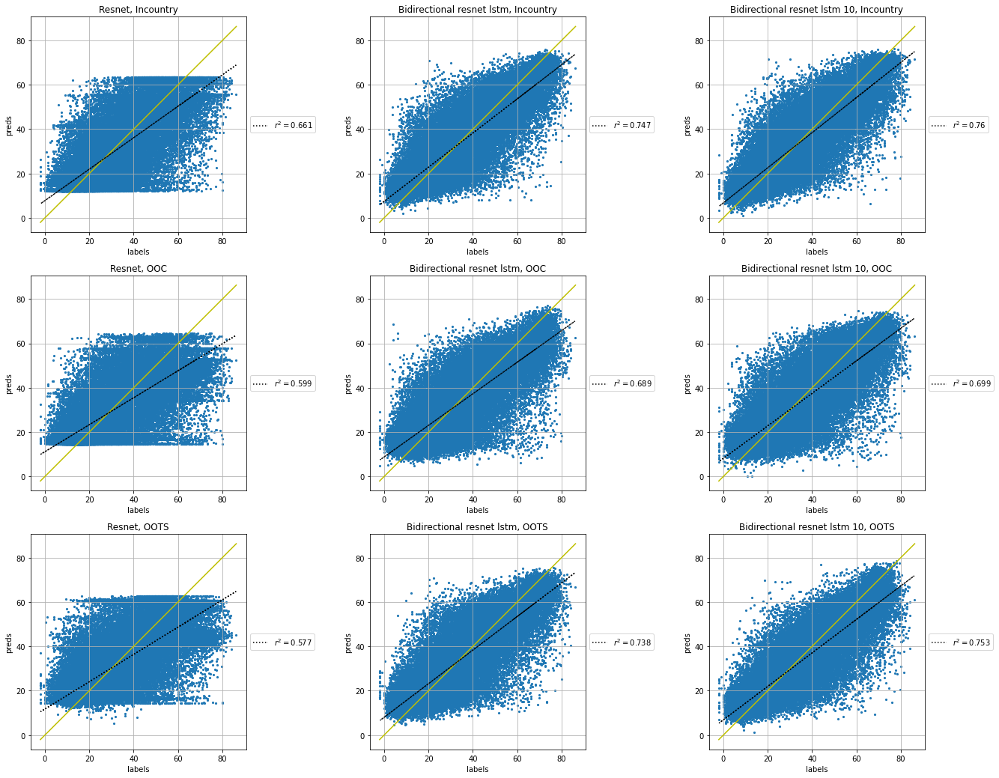

In [6]:
fig, axs = plt.subplots(3, 3, figsize=(23, 18))

for i, fold_config in enumerate(results_dict):
    for j, model_name in enumerate(results_dict[fold_config]):
        results_df = results_dict[fold_config][model_name]
        labels, preds = results_df['iwi'], results_df['y_i']
        fold_config_name = 'Incountry' if i == 0 else fold_config.upper()
        model_name = model_name.replace('_', ' ').capitalize()
        title = model_name + ', ' + fold_config_name
        scatter_preds(labels, preds, by_name=None, by_col=None, ax=axs[i, j],
                  title=title, figsize=(5, 5))

In [7]:
stats_dict = {}

for fold_config in results_dict:
    fold_config_df = df.copy()

    model_pred_cols = []
    for model in results_dict[fold_config]:
        model_pred_col = model
        model_pred_cols.append(model_pred_col)
        model_df = results_dict[fold_config][model]
        fold_config_df[model_pred_col] = model_df['y_i']
        fold_config_df[model_pred_col + '_error'] = model_df['iwi'] - model_df['y_i']

    fold_config_df = fold_config_df.dropna()
    fold_config_df['fold'] = results_dict[fold_config][model]['fold']
    
    stats_dict[fold_config] = fold_config_df

### Model performance per fold

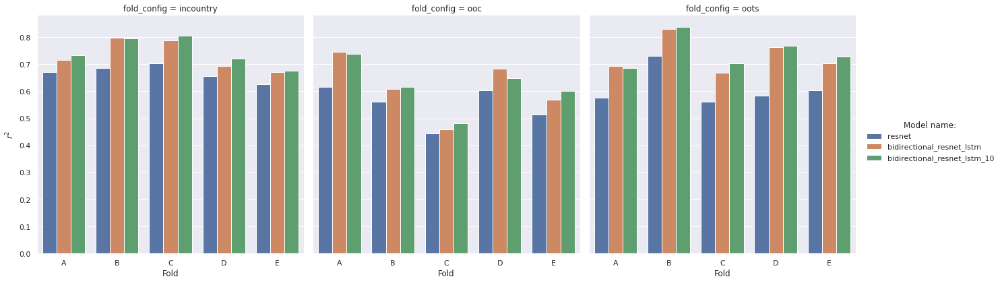

In [8]:
fold_stats_dfs = []

for fold_config in stats_dict:
    fold_config_df = stats_dict[fold_config]
    per_fold_df = fold_config_df.groupby('fold').apply(evaluate_df, cols=model_pred_cols, labels_col='iwi')
    per_fold_df = per_fold_df.reset_index()
    per_fold_df = per_fold_df.rename(columns={'level_1': 'model_name'})
    per_fold_df['fold_config'] = fold_config
    fold_stats_dfs.append(per_fold_df)

fold_stats_df = pd.concat(fold_stats_dfs)

sns.set_theme(style='darkgrid')
# Draw a nested barplot by species and sex
g = sns.catplot(
    data=fold_stats_df, kind='bar',
    x='fold', y='r2', col='fold_config', hue='model_name', height=6
)

g.set_axis_labels('Fold', '$r^2$')
g.legend.set_title('Model name:')

### Urban vs. rural performance

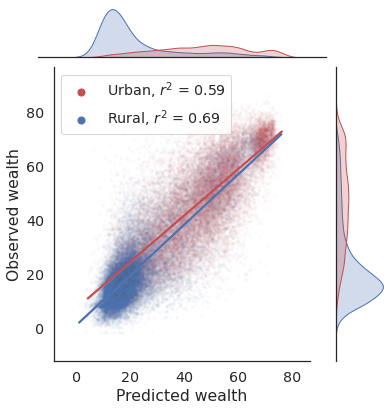

In [17]:
x_col = 'y_i'
y_col = 'iwi'
hue_col = 'rural'
data = results_dict['incountry']['bidirectional_resnet_lstm_10']
#data = data[data['country'] == 'morocco']

sns.set(font_scale=1.3)
sns.set_style('white')
palette = ['r', 'b']
g = sns.jointplot(data=data, x=x_col, y=y_col, hue=hue_col, s=10, 
                  alpha=0.03, linewidth=0, palette=palette)

legend = g.ax_joint.legend()
for lh in legend.legendHandles: 
    lh.set_alpha(1)
    lh.set_sizes([50])

u_data = data[data['rural'] == 0]
u_r2 = scipy.stats.pearsonr(u_data['iwi'], u_data['y_i'])[0] ** 2
r_data = data[data['rural'] == 1]
r_r2 = scipy.stats.pearsonr(r_data['iwi'], r_data['y_i'])[0] ** 2
for t, l in zip(legend.texts, ['Urban, $r^2$ = {:.2f}'.format(u_r2), 'Rural, $r^2$ = {:.2f}'.format(r_r2)]):
    t.set_text(l)

for _,gr in data.groupby(hue_col):
    c = palette.pop(0)
    sns.regplot(x=x_col, y=y_col, data=gr, scatter=False, ax=g.ax_joint, color=c)
    
g.ax_joint.set_aspect('equal')
g.set_axis_labels('Predicted wealth', 'Observed wealth')

plt.savefig('urban_vs_rural.png', dpi=400)
plt.show()

### Urban vs. rural improvement

In [19]:
ooc_df = stats_dict['ooc'].copy()
ooc_df['diff'] = abs(ooc_df['resnet_error']) - abs(ooc_df['bidirectional_resnet_lstm_10_error'])
ooc_df.groupby('rural').mean()['diff']

rural
0    2.616533
1    0.582100
Name: diff, dtype: float64

/local/tmp.762705/ipykernel_21478/1886342711.py:8: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  percentiles = [x.mean() for x in percentiles]
/local/tmp.762705/ipykernel_21478/1886342711.py:8: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  percentiles = [x.mean() for x in percentiles]


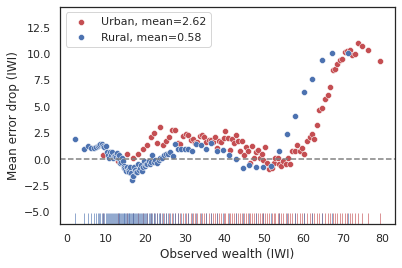

In [24]:
sns.set(font_scale=1)
sns.set_style('white')
ax = plt.subplot()
ax.axhline(0, color='gray', linestyle='dashed')

for rural in [0, 1]:
    percentiles = np.array_split(ooc_df[ooc_df['rural'] == rural].sort_values('iwi'), 100)
    percentiles = [x.mean() for x in percentiles]
    #concat(percentiles)
    percentiles = pd.DataFrame(percentiles)
    label = 'Rural, mean={:.2f}' if rural else 'Urban, mean={:.2f}'
    label = label.format(percentiles['diff'].mean())
    c = 'b' if rural else 'r'
    sns.scatterplot(data=percentiles, x='iwi', y='diff', label=label, color=c)
    sns.rugplot(data=percentiles, x='iwi', height=0.05, alpha=0.6, color=c)

#ax.set_axisbelow(True)
#ax.yaxis.grid(color='gray', linestyle='dashed')
plt.ylabel('Mean error drop (IWI)')
plt.xlabel('Observed wealth (IWI)')
plt.savefig('per_iwi_drop.png', dpi=400)

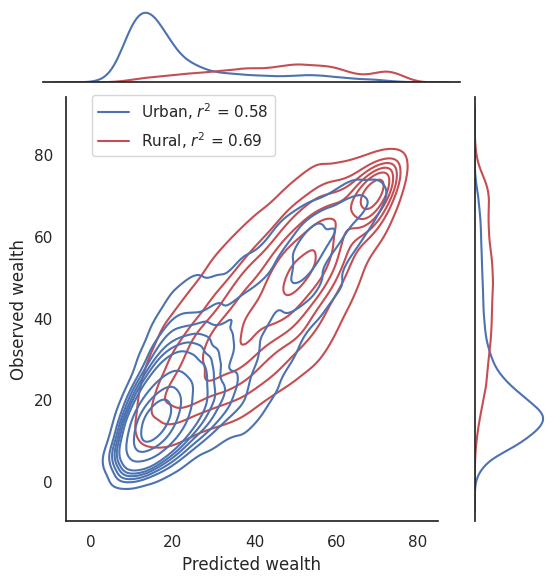

In [92]:
x_col = 'y_i'
y_col = 'iwi'
hue_col = 'rural'
data = results_dict['incountry']['bidirectional_resnet_lstm_10']

sns.set_style('white')
palette = ['r', 'b']
g = sns.jointplot(data=data, x=x_col, y=y_col, hue='rural', kind='kde', palette=palette)
g.ax_joint.legend_._visible=False

u_data = data[data['rural'] == 0]
u_r2 = sklearn.metrics.r2_score(u_data['iwi'], u_data['y_i'])
r_data = data[data['rural'] == 1]
r_r2 = sklearn.metrics.r2_score(r_data['iwi'], r_data['y_i'])

g.fig.legend(['Urban, $r^2$ = {:.2f}'.format(u_r2), 'Rural, $r^2$ = {:.2f}'.format(r_r2)], 
             loc='upper left', bbox_to_anchor=(0.2, 0.1, 0.5, 0.74))
g.ax_joint.set_aspect('equal')
g.set_axis_labels('Predicted wealth', 'Observed wealth')

### Performance per year

In [26]:
oots_df = stats_dict['oots']
    
per_year_df = oots_df.groupby('survey_start_year').apply(evaluate_df, cols=model_pred_cols, labels_col='iwi')
per_year_df = per_year_df.reset_index()
per_year_df = per_year_df.rename(columns={'level_1': 'model_name'})

Evaluate how the OOTS models performances wary with time:

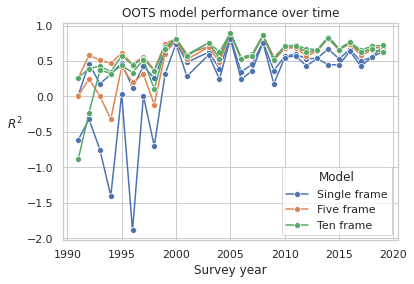

Text(0.5, 1.0, 'OOTS model performance over time')

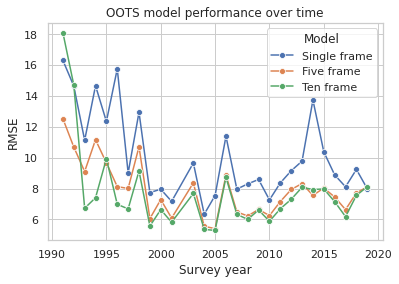

In [28]:
sns.set(style='whitegrid')

# r^2
ax = sns.lineplot(data=per_year_df, x='survey_start_year', y='r2', marker='o', hue='model_name')
ax.set_xlabel('Survey year')
ax.set_ylabel('$r^2$', rotation=0, horizontalalignment='right')
plt.legend(title='Model', labels=['Single-frame', 'Five-frame', 'Ten-frame'])
plt.title('OOTS model performance over time')
plt.show()

# R^2
ax = sns.lineplot(data=per_year_df, x='survey_start_year', y='R2', marker='o', hue='model_name')
ax.set_xlabel('Survey year')
ax.set_ylabel('$R^2$', rotation=0, horizontalalignment='right')
plt.legend(title='Model', labels=['Single frame', 'Five frame', 'Ten frame'])
plt.title('OOTS model performance over time')
plt.show()

# rmse
ax = sns.lineplot(data=per_year_df, x='survey_start_year', y='rmse', marker='o', hue='model_name')
ax.set_xlabel('Survey year')
ax.set_ylabel('RMSE')
plt.legend(title='Model', labels=['Single frame', 'Five frame', 'Ten frame'])
plt.title('OOTS model performance over time')
plt.show()

Since we want to compare our multiframe models to the single frame, do a relative plot as well

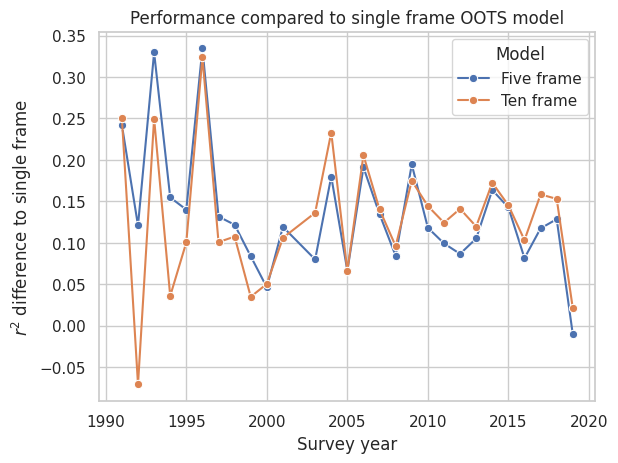

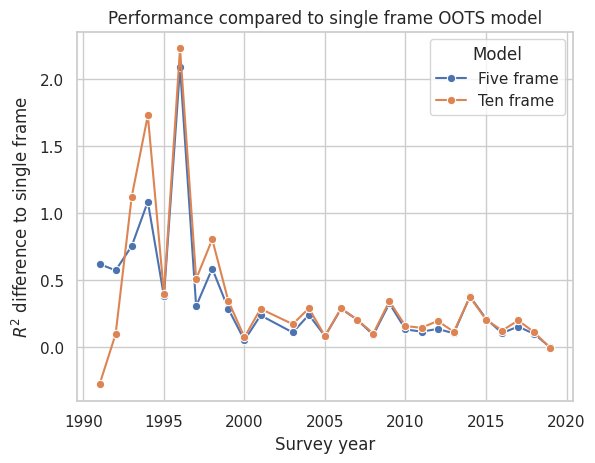

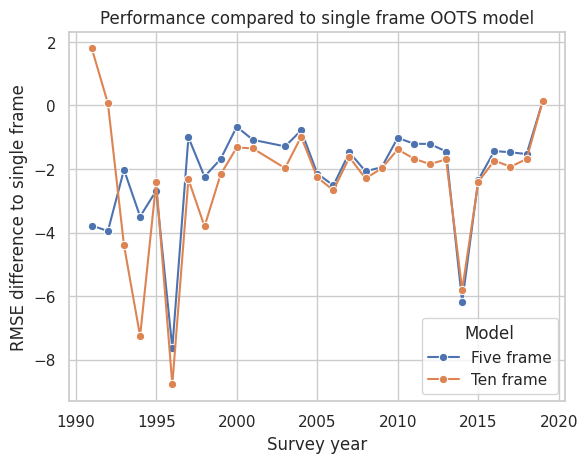

In [50]:
def get_relative_measurements(g):
    g = g.set_index('model_name', drop=True)
    rel_metrics = {
        'r2': {}, 
        'R2': {},
        'mse': {},
        'rmse': {},
        'rank': {}
    }
    for metric in ['r2', 'R2', 'mse', 'rmse', 'rank']:
        for model_name in ['bidirectional_resnet_lstm', 'bidirectional_resnet_lstm_10']:
            rel_metrics[metric][model_name] = g.loc[model_name, metric] - g.loc['resnet', metric]
    return pd.DataFrame(rel_metrics)
    
relative_per_year_df = per_year_df.groupby('survey_start_year').apply(get_relative_measurements)
relative_per_year_df = relative_per_year_df.reset_index()
relative_per_year_df = relative_per_year_df.rename(columns={'level_1': 'model_name'})

# r^2
ax = sns.lineplot(data=relative_per_year_df, x='survey_start_year', y='r2', marker='o', hue='model_name')
ax.set_xlabel('Survey year')
ax.set_ylabel('$r^2$ difference to single frame')
plt.legend(title='Model', labels=['Five frame', 'Ten frame'])
plt.title('Performance compared to single frame OOTS model')
plt.show()

# R^2
ax = sns.lineplot(data=relative_per_year_df, x='survey_start_year', y='R2', marker='o', hue='model_name')
ax.set_xlabel('Survey year')
ax.set_ylabel('$R^2$ difference to single frame')
plt.legend(title='Model', labels=['Five frame', 'Ten frame'])
plt.title('Performance compared to single frame OOTS model')
plt.show()

# rmse
ax = sns.lineplot(data=relative_per_year_df, x='survey_start_year', y='rmse', marker='o', hue='model_name')
ax.set_xlabel('Survey year')
ax.set_ylabel('RMSE difference to single frame')
plt.legend(title='Model', labels=['Five frame', 'Ten frame'])
plt.title('Performance compared to single frame OOTS model')
plt.show()

/local/tmp.661706/ipykernel_1490514/2393051084.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  five_frame_per_year_df['fold'] = five_frame_per_year_df['survey_start_year'].apply(lambda x: year_folds[x])


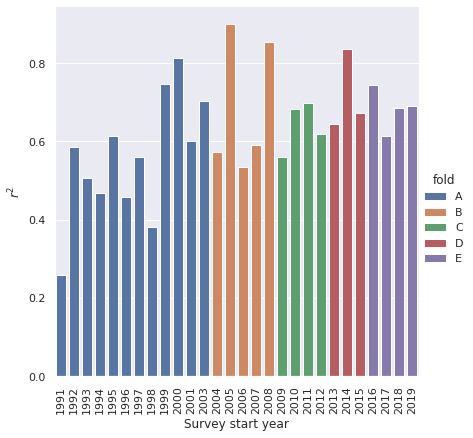

In [22]:
#from sklearn.metrics import r2_score
five_frame_per_year_df = per_year_df[per_year_df['model_name'] == 'bidirectional_resnet_lstm']
#year_r2s = data.groupby('survey_start_year').apply(lambda g: r2_score(g['iwi'], g['y_i'])).reset_index()
year_folds = results_dict['oots']['bidirectional_resnet_lstm'].groupby('survey_start_year').first()['fold']
five_frame_per_year_df['fold'] = five_frame_per_year_df['survey_start_year'].apply(lambda x: year_folds[x])

sns.set_theme(style='darkgrid')
# Draw a nested barplot by species and sex
g = sns.catplot(
    data=five_frame_per_year_df, kind='bar',
    x='survey_start_year', hue='fold', y='r2', height=6, dodge=False
)

g.set_axis_labels('Survey start year', '$r^2$')
g.set_xticklabels(rotation=90)
plt.show()

### Random TS results

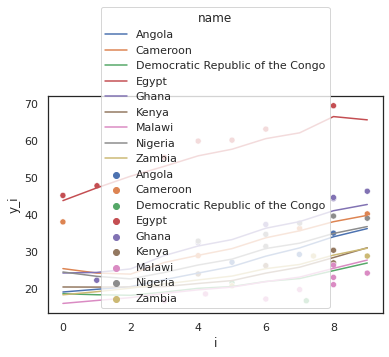

In [73]:
#for j, model_name in enumerate(results_dict[fold_config]):
data = results_dict['incountry']['bidirectional_resnet_lstm'].copy()

country_mean_data = data.groupby('name').mean().reset_index()
preds_dfs = []
for i in range(10):
    y_i = f'y_{i}'
    pred_df = country_mean_data.loc[:, ['name', y_i]]
    pred_df.columns = ['name', 'y_i']
    pred_df['i'] = i
    preds_dfs.append(pred_df)
    
preds_df = pd.concat(preds_dfs).reset_index(drop=True)

countries = list(data['name'].sample(10))
sns.lineplot(data=preds_df[preds_df['name'].isin(countries)], x='i', y='y_i', hue='name')
country_year_mean_data = data.groupby(['name', 'survey_start_year']).mean().reset_index()
sns.scatterplot(data=country_year_mean_data[country_year_mean_data['name'].isin(countries)], x='i', y='iwi', hue='name')
plt.show()
#(preds_df['name'] in countries).any()

### Performance per country

Evaluate old results

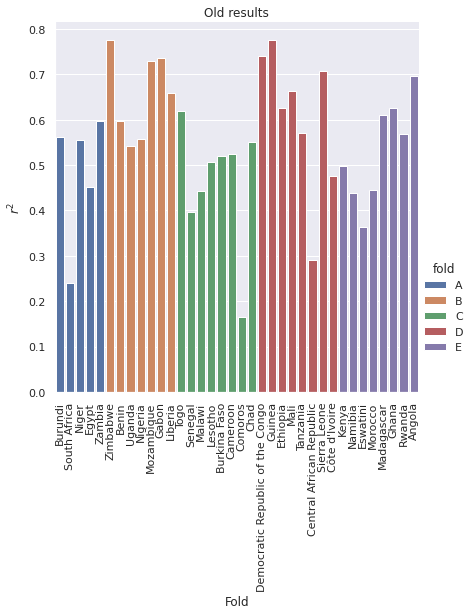

In [28]:
old_r2 = pd.read_csv('evaluate_results/old_results.csv')
country_folds = results_dict['ooc']['resnet'].groupby('country')['fold'].first()
old_r2['fold'] = old_r2['country'].apply(lambda country: country_folds.loc[country])
old_r2['name'] = old_r2['country'].apply(lambda country: rename_names[country])
old_r2.sort_values('fold')[' r2']

sns.set_theme(style='darkgrid')
# Draw a nested barplot by species and sex
g = sns.catplot(
    data=old_r2.sort_values('fold'), kind='bar',
    x='name', y=' r2', height=6, hue='fold', dodge=False
)

g.set_axis_labels('Fold', '$r^2$')
g.set_xticklabels(rotation=90)
plt.title('Old results')
plt.show()

New results:

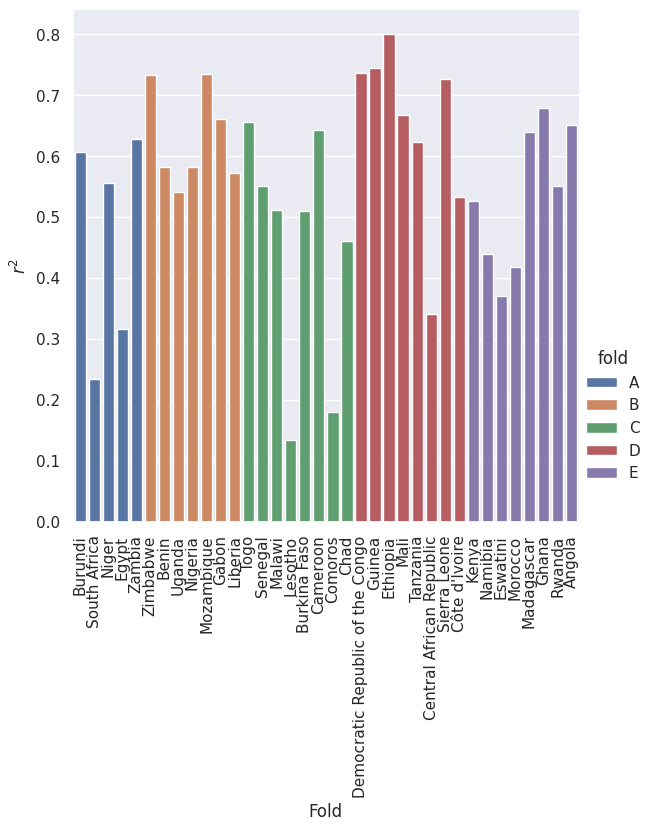

In [70]:
data = results_dict['ooc']['bidirectional_resnet_lstm']
country_stats = data.groupby('country').apply(evaluate_df, cols=['y_i'], labels_col='iwi')
country_stats = country_stats.reset_index()
country_stats = country_stats.set_index('country')
country_stats = country_stats.drop('level_1', axis=1) #= relative_per_year_df.rename(columns={'level_1': 'model_name'})
country_stats['name'] = data.groupby('country')['name'].first()
country_stats['iso_a3'] = data.groupby('country')['iso_a3'].first()
country_stats['fold'] = data.groupby('country')['fold'].first()

sns.set_theme(style='darkgrid')
# Draw a nested barplot by species and sex
g = sns.catplot(
    data=country_stats.sort_values('fold'), kind='bar',
    x='name', y='r2', height=6, hue='fold', dodge=False
)

g.set_axis_labels('Fold', '$r^2$')
g.set_xticklabels(rotation=90)
plt.show()

In [7]:
ooc_df = stats_dict['ooc']
    
per_country_df = ooc_df.groupby('country').apply(evaluate_df, cols=MODEL_NAMES, labels_col='iwi')
per_country_df = per_country_df.reset_index()
per_country_df = per_country_df.rename(columns={'level_1': 'model_name'})

Try to predict country performance

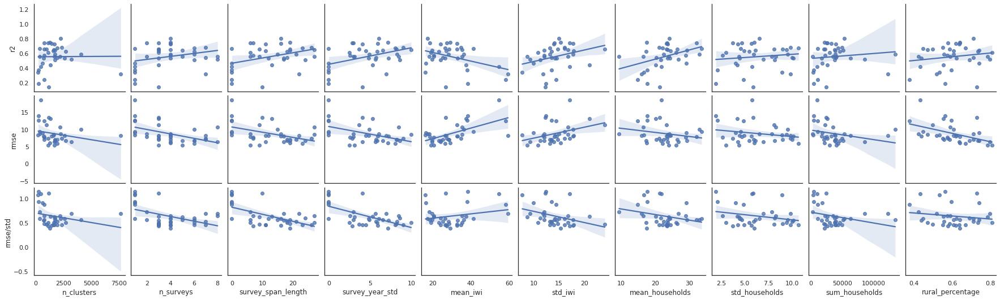

In [131]:
def get_country_descriptors(g):
    country_descriptors = {}
    country_descriptors['n_clusters'] = len(g)
    survey_years = g['survey_start_year'].unique()
    country_descriptors['n_surveys'] = len(survey_years)
    country_descriptors['survey_span_length'] = survey_years[-1] - survey_years[0]
    country_descriptors['survey_year_std'] = np.std(survey_years)
    country_descriptors['survey_year_std'] = np.std(survey_years)
    country_descriptors['mean_iwi'] = g['iwi'].mean()
    country_descriptors['std_iwi'] = g['iwi'].std()
    country_descriptors['mean_households'] = g['households'].mean()
    country_descriptors['std_households'] = g['households'].std()
    country_descriptors['sum_households'] = g['households'].sum()
    country_descriptors['std_households'] = g['households'].std()
    country_descriptors['rural_percentage'] = g['rural'].mean()
    return pd.Series(country_descriptors)

country_descriptors = ooc_df.groupby('country').apply(get_country_descriptors)
descriptors = country_descriptors.columns.tolist()
country_descriptors['r2'] = per_country_df[per_country_df['model_name'] == 'bidirectional_resnet_lstm']['r2'].values
country_descriptors['rmse'] = per_country_df[per_country_df['model_name'] == 'bidirectional_resnet_lstm']['rmse'].values
country_descriptors['rmse/std'] = country_descriptors['rmse'] / country_descriptors['std_iwi']

sns.pairplot(country_descriptors, kind="reg", x_vars=descriptors, y_vars=['r2', 'rmse', 'rmse/std'])

In [136]:
for descriptor in descriptors:
    x = country_descriptors[descriptor]
    r2_corr, r2_p = scipy.stats.pearsonr(x, country_descriptors['r2'])
    print(f'{descriptor}: r2={(r2_corr ** 2):.2f}, p={(r2_p):.3f}, ap={(r2_p*len(descriptor)):.3f}')

n_clusters: r2=0.00, p=0.967, ap=9.667
n_surveys: r2=0.07, p=0.118, ap=1.059
survey_span_length: r2=0.14, p=0.022, ap=0.396
survey_year_std: r2=0.18, p=0.011, ap=0.164
mean_iwi: r2=0.16, p=0.015, ap=0.120
std_iwi: r2=0.10, p=0.055, ap=0.388
mean_households: r2=0.17, p=0.013, ap=0.196
std_households: r2=0.02, p=0.430, ap=6.017
sum_households: r2=0.01, p=0.482, ap=6.751
rural_percentage: r2=0.03, p=0.302, ap=4.826


### Make KDE plots for country performance

In [8]:
per_country_df[per_country_df['model_name'] == 'bidirectional_resnet_lstm_10'].median()

/local/tmp.776036/ipykernel_44385/1514069923.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  per_country_df[per_country_df['model_name'] == 'bidirectional_resnet_lstm_10'].median()


r2        0.595306
R2        0.527637
mse     103.190933
rmse      7.887946
rank      0.696803
dtype: float64

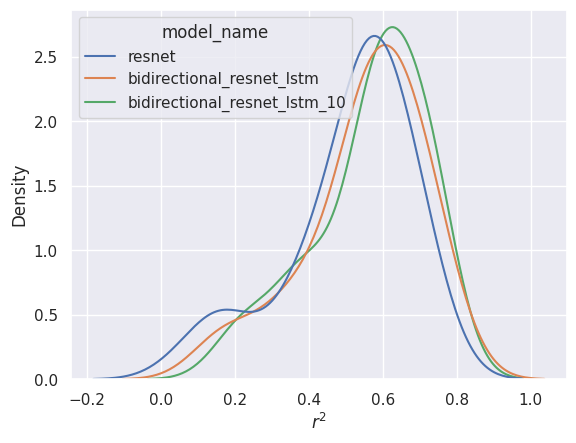

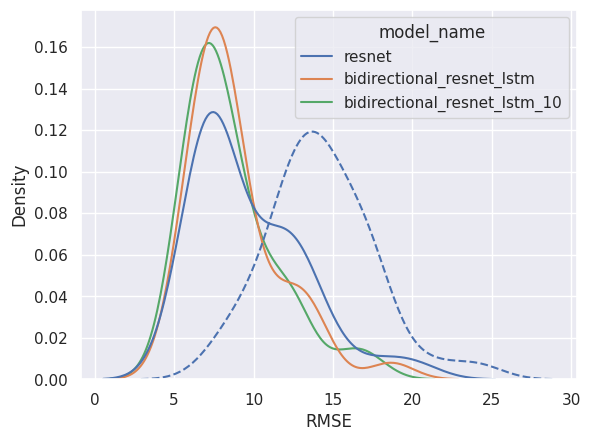

In [88]:
g = sns.kdeplot(data=per_country_df, x='r2', hue='model_name', common_norm=False)
g.set_xlabel('$r^2$')
plt.show()

g = sns.kdeplot(data=per_country_df, x='rmse', hue='model_name', common_norm=False)
sns.kdeplot(data=df.groupby('country').std(), x='iwi',  linestyle="--", ax=g)
g.set_xlabel('RMSE')
plt.show()

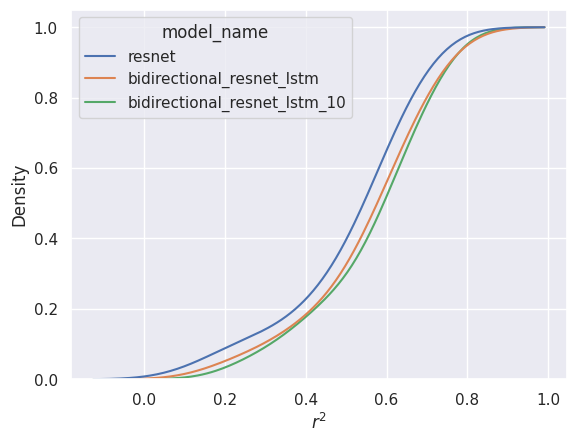

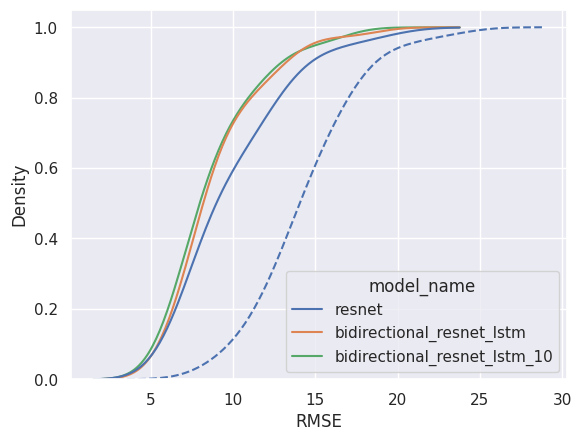

In [89]:
g = sns.kdeplot(data=per_country_df, x='r2', hue='model_name',
               cumulative=True, common_norm=False, common_grid=True)
g.set_xlabel('$r^2$')
plt.show()

g = sns.kdeplot(data=per_country_df, x='rmse', hue='model_name',
               cumulative=True, common_norm=False, common_grid=True)
sns.kdeplot(data=df.groupby('country').std(), x='iwi', linestyle="--", ax=g,
           cumulative=True, common_norm=False, common_grid=True)
g.set_xlabel('RMSE')
plt.show()

Export results to csv

In [14]:
per_country_df.to_csv('evaluate_results/country_stats.csv', index=False)

### Performance per survey

In [129]:
df.groupby('name').size()

36

In [15]:
data = results_dict['incountry']['bidirectional_resnet_lstm']
rural_survey_df = data.groupby(['name', 'survey_start_year', 'rural']).apply(evaluate_df, cols=['y_i'], labels_col='iwi') 
survey_df = data.groupby(['name', 'survey_start_year']).apply(evaluate_df, cols=['y_i'], labels_col='iwi') 
rural_survey_df

r2        R2         mse  \
name     survey_start_year rural                                       
Angola   2006              0     y_i  0.052618 -2.930927  775.887598   
                           1     y_i  0.039963 -0.330034   79.882785   
         2011              0     y_i  0.430913  0.414463   75.155220   
                           1     y_i  0.295081 -0.545224  133.762360   
         2015              0     y_i  0.346803  0.294227  222.984485   
...                                        ...       ...         ...   
Zimbabwe 2005              1     y_i  0.154199  0.075674   51.582287   
         2010              0     y_i  0.238802 -0.275826  106.532827   
                           1     y_i  0.336034  0.224959   59.234256   
         2015              0     y_i  0.120729 -0.757941  138.595506   
                           1     y_i  0.289810 -0.514937   90.380242   

                                           rmse      rank  
name     survey_start_year rural                           
Angola   2006              0     y_i  24.354955  0.244247  
                           1     y_i   7.580947  0.397023  
         2011              0     y_i   6.728464  0.520523  
                           1     y_i   9.392817  0.430796  
         2015              0     y_i  12.084163  0.570730  
...                                         ...       ...  
Zimbabwe 2005              1     y_i   5.321026  0.346257  
         2010              0     y_i   8.052074  0.410436  
                           1     y_i   5.767390  0.457425  
         2015              0     y_i   9.285087  0.269785  
                           1     y_i   7.543531  0.434595  

[276 rows x 5 columns]

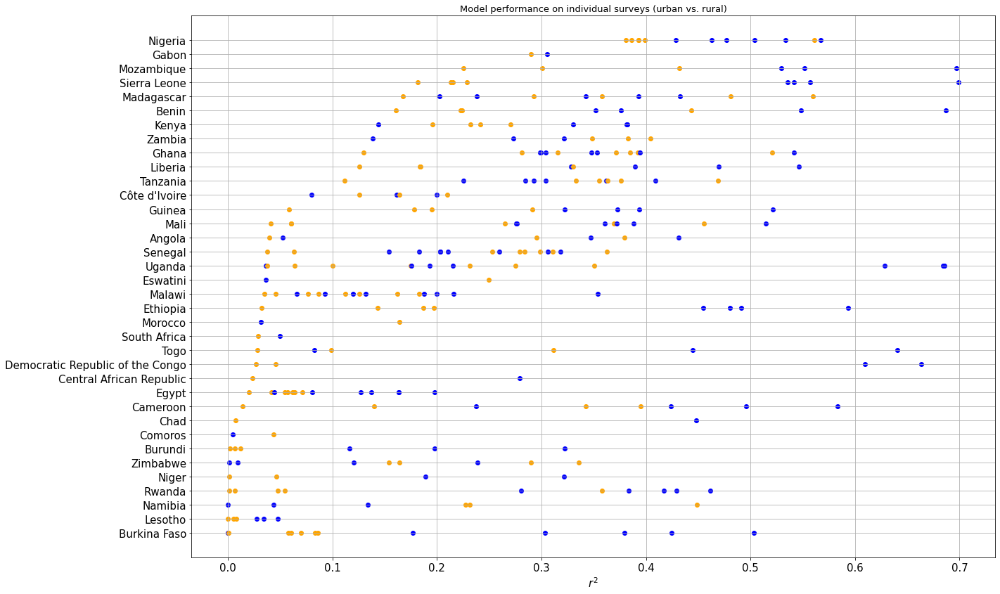

In [21]:
def plot_survey_performance(survey_results, title, urban_rural=False, metric='r2', ascending=True):

    fig, ax = plt.subplots(1, 1, figsize=(20, 12))
    for i in survey_results.sort_values(metric, ascending=ascending).index:
        survey = survey_results.loc[i]
        metric_value = survey[metric]
        country = survey['name']
        year = survey['survey_start_year']
        #size = (survey['n_surveys'] / len(df)) * 10000
        if urban_rural:
            color='orange' if survey['rural'] else 'blue'
        else:
            color = (year - 1990) / 30
            color = [(0, color, color)]
        ax.scatter(x=metric_value, y=country, label=year, c=color, cmap='flare')

    # ax.invert_yaxis()  # invert direction to put best-performing models at the top
    plt.rcParams.update({'font.size': 15})
    plt.rc('axes', titlesize=13)
    plt.rcParams.update({'font.size': 15})
    ax.grid(True)
    ax.set_title(title)
    ax.set_xlabel('$r^2$')
    # ax.legend(loc='center left',ncol=3, bbox_to_anchor=(1, 0.5))
    # x.legend(loc="lower left", ncol=5, bbox_to_anchor=(0, -1.28))
    fig.tight_layout()
    plt.show()
    
plot_survey_performance(rural_survey_df.reset_index(), 'Model performance on individual surveys (urban vs. rural)', urban_rural=True)

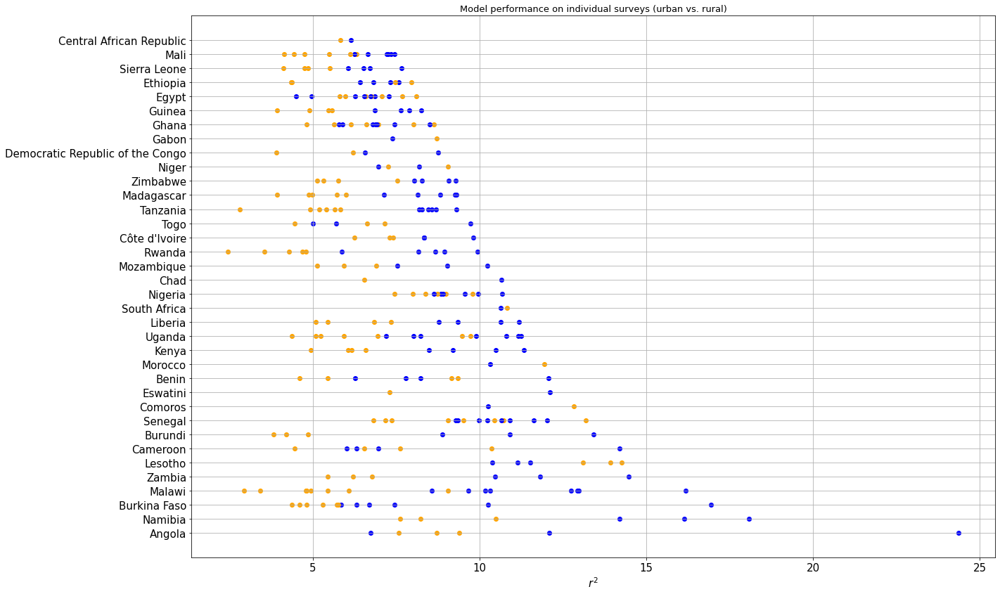

In [22]:
plot_survey_performance(rural_survey_df.reset_index(), 'Model performance on individual surveys (urban vs. rural)', urban_rural=True, metric='rmse', ascending=False)

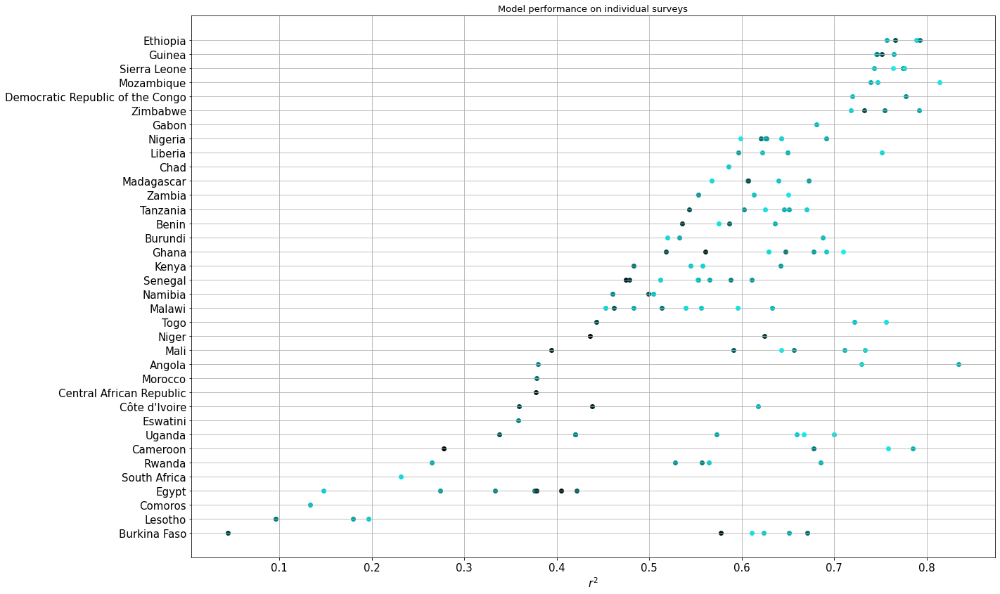

In [17]:
plot_survey_performance(survey_df.reset_index(), 'Model performance on individual surveys', urban_rural=False)

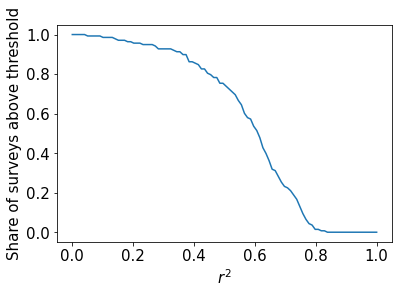

In [13]:
x = np.linspace(0, 1, 100)
y = [np.mean(survey_df['r2'] > x_i) for x_i in x]
g = sns.lineplot(x=x, y=y)
g.set_xlabel('$r^2$')
g.set_ylabel('Share of surveys above threshold')
plt.show()

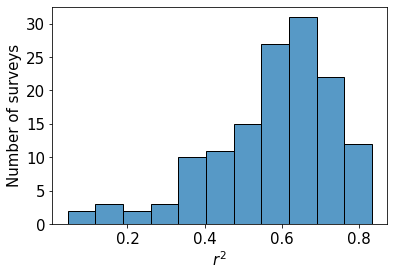

In [18]:
g = sns.histplot(data=survey_df, x='r2')
g.set_xlabel('$r^2$')
g.set_ylabel('Number of surveys')
plt.show()

### Group at region level

Aggregate predictions and labels to the national, GID 1 and GID 2 levels.

In [17]:
# Aggregate results
def aggregate_results(data, aggregate_columns):
    aggregate_group = data.groupby(aggregate_columns)
    if (aggregate_columns == 'country') or ('country' in aggregate_columns):
        aggregate_df = aggregate_group.agg({'iwi':'mean', 'y_i':'mean', 'households':'sum'})
    else:
        aggregate_df = aggregate_group.agg({'country':'first', 'iwi':'mean', 'y_i':'mean', 'households':'sum'})
    aggregate_df['n_clusters'] = aggregate_group.size()
    return aggregate_df

data = results_dict['ooc']['bidirectional_resnet_lstm_10']
country_df = aggregate_results(data, 'country')
gid_1_df = aggregate_results(data, 'GID_1')
gid_2_df = aggregate_results(data, 'GID_2')

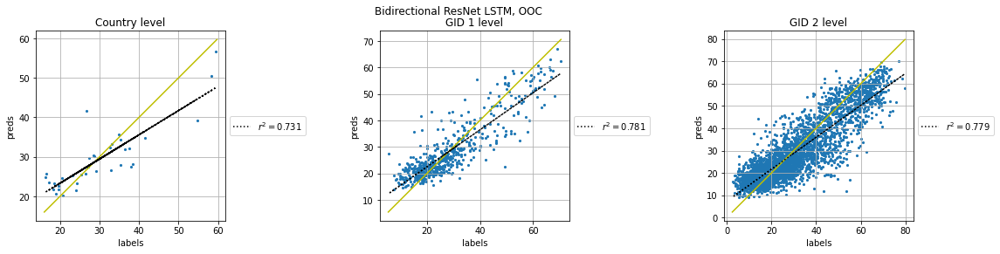

In [18]:
fig, axs = plt.subplots(1, 3, figsize=(20, 4))

fig.suptitle('Bidirectional ResNet LSTM, OOC')
scatter_preds(country_df['iwi'], country_df['y_i'], by_name=None, by_col=None,
              title='Country level', ax=axs[0])
scatter_preds(gid_1_df['iwi'], gid_1_df['y_i'], by_name=None, by_col=None,
              title='GID 1 level', ax=axs[1])
scatter_preds(gid_2_df['iwi'], gid_2_df['y_i'], by_name=None, by_col=None,
              title='GID 2 level', ax=axs[2])
fig.show()

Calculate national level statistics for aggregated data

In [7]:
# Aggregate results
def aggregate_results(data, aggregate_columns):
    aggregate_group = data.groupby(aggregate_columns)
    if (aggregate_columns == 'country') or ('country' in aggregate_columns):
        aggregate_df = aggregate_group.agg({'iwi':'mean', 'y_i':'mean', 'households':'sum'})
    else:
        aggregate_df = aggregate_group.agg({'country':'first', 'iwi':'mean', 'y_i':'mean', 'households':'sum'})
    aggregate_df['n_clusters'] = aggregate_group.size()
    return aggregate_df

def get_country_stats(aggregate_df, data):
    country_aggregate_df = aggregate_df.groupby(['country']).apply(evaluate_df, cols=['y_i'], labels_col='iwi')
    country_aggregate_df = country_aggregate_df.reset_index().set_index('country')
    country_aggregate_df = country_aggregate_df.drop('level_1', axis=1)

    for var in ['fold', 'name', 'iso_a3']:
        country_aggregate_df[var] = data.groupby('country').first()[var]

    return country_aggregate_df

data = results_dict['ooc']

for level in ['cluster', 'GID_1', 'GID_2']:
    level_stats_dfs = []
    for model_name in data.keys():
        model_df = data[model_name]
        if level == 'cluster':
            level_df = model_df[['country', 'iwi', 'y_i', 'households']]
            #level_df['n_clusters'] = 1
        else:
            level_df = aggregate_results(model_df, level)
            
        level_stats_df = get_country_stats(level_df, model_df)
        level_stats_df['model_name'] = model_name
        level_stats_dfs.append(level_stats_df)
    level_stats_df = pd.concat(level_stats_dfs).sort_values(['country', 'model_name'])
    level_stats_df.to_csv(f'evaluate_results/{level}_stats.csv', index=False)

In [19]:
def get_country_stats(aggregate_df, data):
    country_aggregate_df = aggregate_df.groupby(['country']).apply(evaluate_df, cols=['y_i'], labels_col='iwi')
    country_aggregate_df = country_aggregate_df.reset_index().set_index('country')
    country_aggregate_df = country_aggregate_df.drop('level_1', axis=1)

    for var in ['fold', 'name', 'iso_a3']:
        country_aggregate_df[var] = data.groupby('country').first()[var]

    return country_aggregate_df

gid_1_country_stats_df = get_country_stats(gid_1_df, data)
gid_2_country_stats_df = get_country_stats(gid_2_df, data)

print('Country stats for GID 1 aggregates:')
print(gid_1_country_stats_df.describe())

print('Country stats for GID 2 aggregates:')
print(gid_2_country_stats_df.describe())

Country stats for GID 1 aggregates:
              r2         R2         mse       rmse       rank
count  36.000000  36.000000   36.000000  36.000000  36.000000
mean    0.786948  -0.315395   47.291802   5.150329   0.711400
std     0.206239   2.167204   65.216276   3.604262   0.211276
min     0.114146  -7.684487    1.246552   0.985225   0.107843
25%     0.746635  -0.105125   12.098851   2.763525   0.621687
50%     0.851324   0.572455   19.529700   3.971119   0.757792
75%     0.906348   0.788559   54.032717   6.445523   0.845372
max     0.999772   0.987910  308.440299  16.638104   0.987879
Country stats for GID 2 aggregates:
              r2         R2         mse       rmse       rank
count  36.000000  36.000000   36.000000  36.000000  36.000000
mean    0.680975  -0.195657   63.208947   5.925389   0.682223
std     0.177076   1.745626   77.973212   3.577414   0.161781
min     0.117777  -7.572277    2.329201   1.211203   0.158893
25%     0.616093  -0.109745   16.949920   3.199411   0.55364

In [22]:
per_country_df

,country,model_name,r2,R2,mse,rmse,rank
0,angola,resnet,0.615594,0.610364,225.335541,11.686503,0.739387
1,angola,bidirectional_resnet_lstm,0.651099,0.641946,207.071035,11.350513,0.773600
2,angola,bidirectional_resnet_lstm_10,0.677599,0.661627,195.689360,11.092639,0.785694
3,benin,resnet,0.590283,0.528976,82.145979,6.951165,0.727937
4,benin,bidirectional_resnet_lstm,0.582640,0.543739,79.571369,6.990949,0.721147
...,...,...,...,...,...,...,...
103,zambia,bidirectional_resnet_lstm,0.628484,0.625694,120.003614,8.247934,0.795273
104,zambia,bidirectional_resnet_lstm_10,0.632623,0.631738,118.065752,8.148772,0.789025
105,zimbabwe,resnet,0.690320,0.660881,107.637415,7.871495,0.755146
106,zimbabwe,bidirectional_resnet_lstm,0.733895,0.664930,106.352182,7.987066,0.779888


In [20]:
gid_2_country_stats_df.to_csv('evaluate_results/gid_2_stats.csv', index=False)

,r2,R2,mse,rmse,rank,fold,name,iso_a3
country,,,,,,,,
angola,0.780447,0.730827,68.806024,7.060658,0.747655,E,Angola,AGO
benin,0.816697,0.724512,14.192377,2.993664,0.778154,B,Benin,BEN
burkina_faso,0.644636,0.398788,13.130237,2.810368,0.695125,C,Burkina Faso,BFA
burundi,0.782444,0.763353,24.153245,3.547367,0.541603,A,Burundi,BDI
cameroon,0.692362,0.636376,27.475733,4.284957,0.758959,C,Cameroon,CMR
central_african_republic,0.117777,-4.792524,82.413433,8.018351,0.158893,D,Central African Republic,CAF
chad,0.615362,-2.874348,96.357947,9.061635,0.597258,C,Chad,TCD
comoros,0.809362,-0.717891,92.582191,8.510019,0.500000,C,Comoros,COM
democratic_republic_of_congo,0.678340,0.330586,56.290740,6.132282,0.555593,D,Democratic Republic of the Congo,COD


In [164]:
country_stats2 = country_stats.copy()
country_stats2['std'] = df.groupby('country').std()['iwi'].values
country_stats2['rmse/std'] = country_stats2['rmse'] / country_stats2['std']
country_stats2.sort_values('rmse/std', ascending=False)

country_stats2.sort_values('rmse/std')

,r2,R2,mse,rmse,rank,name,iso_a3,fold,std,rmse/std
country,,,,,,,,,,
guinea,0.745369,0.740111,60.758542,5.988410,0.799530,Guinea,GIN,D,15.296074,0.391500
mozambique,0.735151,0.688449,91.518066,7.382022,0.759797,Mozambique,MOZ,B,17.146693,0.430522
zimbabwe,0.733895,0.664930,106.352182,7.987066,0.779888,Zimbabwe,ZWE,B,17.822173,0.448153
mali,0.668263,0.658383,59.160496,5.949056,0.675802,Mali,MLI,D,13.163096,0.451950
zambia,0.628484,0.625694,120.003614,8.247934,0.795273,Zambia,ZMB,A,17.911077,0.460493
sierra_leone,0.726149,0.667387,64.955154,6.448511,0.751746,Sierra Leone,SLE,D,13.978696,0.461310
ghana,0.679920,0.646898,92.117881,7.454122,0.831050,Ghana,GHA,E,16.155312,0.461404
angola,0.651099,0.641946,207.071035,11.350513,0.773600,Angola,AGO,E,24.060783,0.471743
togo,0.656724,0.606951,85.333378,7.110958,0.741147,Togo,TGO,C,14.744066,0.482293


In [165]:
country_stats2.describe()

,r2,R2,mse,rmse,rank,std,rmse/std
count,36.000000,36.000000,36.000000,36.000000,36.000000,36.000000,36.000000
mean,0.551486,0.279679,137.494735,8.817290,0.658400,14.236479,0.636589
std,0.161619,0.481386,96.679751,2.869243,0.123201,3.319662,0.208352
min,0.134081,-0.983924,54.613424,5.344376,0.307010,7.763575,0.391500
25%,0.497919,0.236833,79.486224,6.943057,0.602062,12.104847,0.495006
50%,0.577261,0.485784,103.972971,8.122715,0.666890,14.052246,0.572338
75%,0.657861,0.594263,145.671809,9.507719,0.753750,16.311211,0.686870
max,0.800367,0.740111,539.347489,18.670523,0.835934,24.060783,1.134032


Save to CSV

In [117]:
gid_1_country_stats_df.to_csv('evaluate_results/gid_1_country_stats_df.csv', index=True)
gid_2_country_stats_df.to_csv('evaluate_results/gid_2_country_stats_df.csv', index=True)

### Regional level stats

Get statistics for GID level 1, similar to country level above:

In [35]:
data = results_dict['ooc']['bidirectional_resnet_lstm_10']
evaluate_df(data.groupby(['GID_2']).mean(), cols=['y_i'], labels_col='iwi') # .apply(evaluate_df, cols=['y_i'], labels_col='iwi')
#0.778562 - 0.689337

,r2,R2,mse,rmse,rank
y_i,0.598551,0.592984,153.981785,9.394429,0.74268


In [11]:
data = results_dict['ooc']['bidirectional_resnet_lstm']
# Drop regions with a single entry since those can't be used for stats
clean_data = data[data.duplicated(subset='GID_1', keep=False)]
gid_1_stats_df = clean_data.groupby(['GID_1']).apply(evaluate_df, cols=['y_i'], labels_col='iwi')
gid_1_stats_df = gid_1_stats_df.reset_index().set_index('GID_1')
gid_1_stats_df = gid_1_stats_df.drop('level_1', axis=1)
gid_1_stats_df.describe()

/usr/local/lib/python3.8/dist-packages/scipy/stats/stats.py:3508: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


,r2,R2,mse,rmse,rank
count,563.000000,564.000000,564.000000,564.000000,563.000000
mean,0.418108,-0.468799,129.751238,8.547218,0.519264
std,0.207309,3.161509,121.974826,3.575884,0.219040
min,0.000029,-55.871211,15.799014,3.462976,-0.633333
25%,0.268961,-0.389937,63.413193,6.267583,0.404701
50%,0.439087,0.163137,95.632083,7.759221,0.560710
75%,0.576992,0.433321,146.795442,9.922719,0.679148
max,0.994902,0.811194,1072.180250,27.299037,0.888396


Save to csv

In [77]:
gid_1_stats_df.to_csv('evaluate_results/gid_1_stats.csv', index=True)

### Relative OOC stats:
Get country level stats for all models

In [48]:
ooc_df = stats_dict['ooc']
    
per_country_df = ooc_df.groupby('country').apply(evaluate_df, cols=MODEL_NAMES, labels_col='iwi')
per_country_df = per_country_df.reset_index()
per_country_df = per_country_df.rename(columns={'level_1': 'model_name'})

Get relative stats compared to single frame

In [53]:
relative_per_country_df = per_country_df.groupby('country').apply(get_relative_measurements)
relative_per_country_df = relative_per_country_df.reset_index()
relative_per_country_df = relative_per_country_df.rename(columns={'level_1': 'model_name'})
relative_per_country_df['iso_a3'] = relative_per_country_df['country'].apply(lambda x: iso_a3_codes[x])

Distribution of difference for metrics compared to single frame

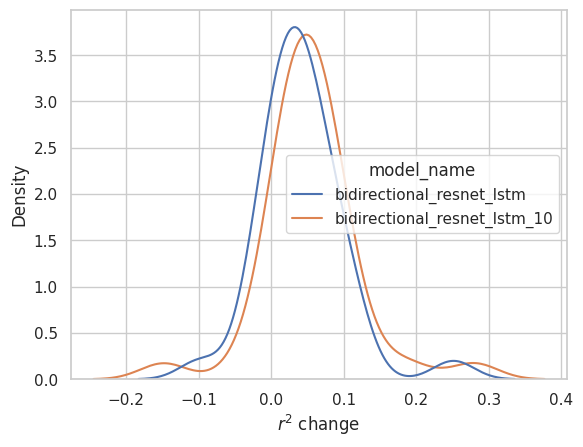

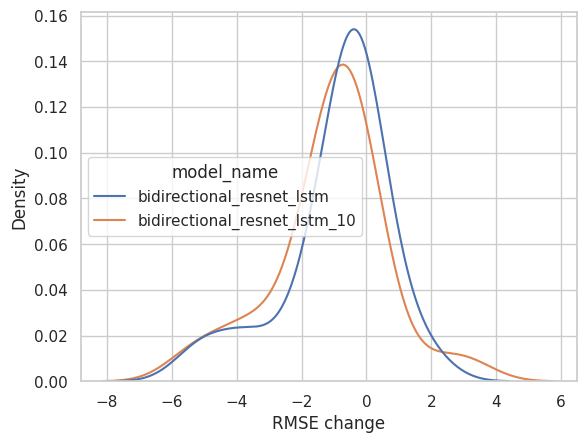

In [68]:
g = sns.kdeplot(data=relative_per_country_df, x='r2', hue='model_name')
g.set_xlabel('$r^2$ change')
plt.show()

g = sns.kdeplot(data=relative_per_country_df, x='rmse', hue='model_name')
g.set_xlabel('RMSE change')
plt.show()

Same thing, but cumulative

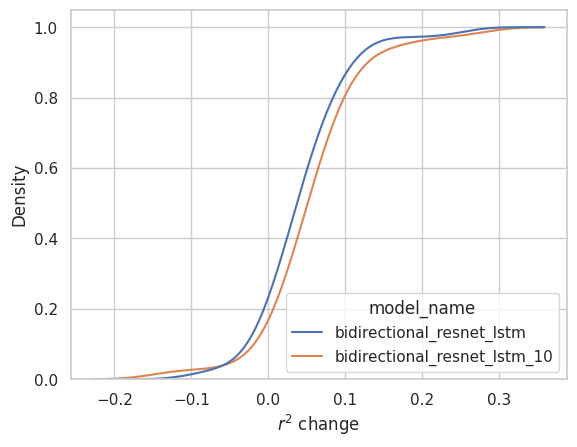

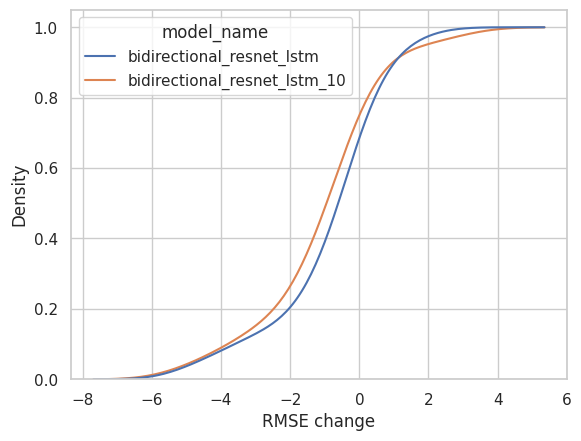

In [69]:
g = sns.kdeplot(data=relative_per_country_df, x='r2', hue='model_name',
               cumulative=True, common_norm=False, common_grid=True)
g.set_xlabel('$r^2$ change')
plt.show()

g = sns.kdeplot(data=relative_per_country_df, x='rmse', hue='model_name',
               cumulative=True, common_norm=False, common_grid=True)
g.set_xlabel('RMSE change')
plt.show()

Save to csv

In [55]:
relative_per_country_df.to_csv('evaluate_results/relative_country_stats.csv', index=False)

Get region level stats for all models

In [85]:
ooc_df = df.copy()

model_pred_cols = []
for model in results_dict['ooc']:
    model_pred_col = model
    model_pred_cols.append(model_pred_col)
    ooc_df[model_pred_col] = results_dict['ooc'][model]['y_i']

ooc_df = ooc_df.dropna()

# Drop regions with a single entry since those can't be used for stats
clean_ooc_df = ooc_df[ooc_df.duplicated(subset='GID_1', keep=False)]
    
per_gid_1_df = clean_ooc_df.groupby('GID_1').apply(evaluate_df, cols=model_pred_cols, labels_col='iwi')
per_gid_1_df = per_gid_1_df.reset_index()
per_gid_1_df = per_gid_1_df.rename(columns={'level_1': 'model_name'})

/usr/local/lib/python3.8/dist-packages/scipy/stats/stats.py:3508: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/usr/local/lib/python3.8/dist-packages/scipy/stats/stats.py:3508: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/usr/local/lib/python3.8/dist-packages/scipy/stats/stats.py:3508: PearsonRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(PearsonRConstantInputWarning())


Get relative stats compared to single frame

In [90]:
relative_per_gid_1_df = per_gid_1_df.groupby('GID_1').apply(get_relative_measurements)
relative_per_gid_1_df = relative_per_gid_1_df.reset_index()
relative_per_gid_1_df = relative_per_gid_1_df.rename(columns={'level_1': 'model_name'})

Save to csv

In [93]:
relative_per_gid_1_df.to_csv('evaluate_results/relative_per_gid_1_stats.csv', index=False)

## 

## Compare to QOG

In [57]:
qog_df = pd.read_csv('https://www.qogdata.pol.gu.se/data/qog_std_ts_jan22.csv')
qog_df = qog_df[(qog_df['year'] > 1989) & (qog_df['year'] < 2020)]
qog_df = qog_df[qog_df['ccodealp'].isin(list(iso_a3_codes.values()))]
qog_df

/local/tmp.680051/ipykernel_3797590/2037931157.py:1: DtypeWarning: Columns (793,797,801,805,1268,1269) have mixed types. Specify dtype option on import or set low_memory=False.
  qog_df = pd.read_csv('https://www.qogdata.pol.gu.se/data/qog_std_ts_jan22.csv')


,ccode,cname,year,ccode_qog,cname_qog,ccodealp,ccodecow,version,cname_year,ccodealp_year,...,wwbi_rrespubpemp,wwbi_sprpempn,wwbi_sprpempp,wwbi_sprpemps,wwbi_sprpempt,wwbi_spupempn,wwbi_spupempp,wwbi_spupemps,wwbi_spupempt,wwbi_tertiarypubsec
348,24,Angola,1990,24,Angola,AGO,540.0,QoGStdTSjan22,Angola 1990,AGO90,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
349,24,Angola,1991,24,Angola,AGO,540.0,QoGStdTSjan22,Angola 1991,AGO91,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
350,24,Angola,1992,24,Angola,AGO,540.0,QoGStdTSjan22,Angola 1992,AGO92,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
351,24,Angola,1993,24,Angola,AGO,540.0,QoGStdTSjan22,Angola 1993,AGO93,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
352,24,Angola,1994,24,Angola,AGO,540.0,QoGStdTSjan22,Angola 1994,AGO94,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14932,894,Zambia,2015,894,Zambia,ZMB,551.0,QoGStdTSjan22,Zambia 2015,ZMB15,...,0.226445,0.028817,0.172776,0.578589,0.219818,0.017781,0.109138,0.342219,0.530862,0.501821
14933,894,Zambia,2016,894,Zambia,ZMB,551.0,QoGStdTSjan22,Zambia 2016,ZMB16,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14934,894,Zambia,2017,894,Zambia,ZMB,551.0,QoGStdTSjan22,Zambia 2017,ZMB17,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14935,894,Zambia,2018,894,Zambia,ZMB,551.0,QoGStdTSjan22,Zambia 2018,ZMB18,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


['AGO',
 'BEN',
 'BFA',
 'BDI',
 'CMR',
 'CAF',
 'TCD',
 'COM',
 'COD',
 'EGY',
 'SWZ',
 'ETH',
 'GAB',
 'GHA',
 'GIN',
 'CIV',
 'KEN',
 'LSO',
 'LBR',
 'MDG',
 'MWI',
 'MLI',
 'MAR',
 'MOZ',
 'NAM',
 'NER',
 'NGA',
 'RWA',
 'SEN',
 'SLE',
 'ZAF',
 'TZA',
 'TGO',
 'UGA',
 'ZMB',
 'ZWE']

In [51]:
qog_cc = qog_df['ccodealp'].unique()
for cc in df['iso_a3'].unique():
    print(cc, cc in qog_cc)

AGO True
BEN True
BFA True
BDI True
CMR True
CAF True
TCD True
COM True
COD True
EGY True
SWZ True
ETH True
GAB True
GHA True
GIN True
CIV True
KEN True
LSO True
LBR True
MDG True
MWI True
MLI True
MAR True
MOZ True
NAM True
NER True
NGA True
RWA True
SEN True
SLE True
ZAF True
TZA True
TGO True
UGA True
ZMB True
ZWE True


array(['AGO', 'BEN', 'BFA', 'BDI', 'CMR', 'CAR', 'TCD', 'COM', 'COD',
       'EGY', 'SWZ', 'ETH', 'GAB', 'GHA', 'GIN', 'CIV', 'KEN', 'LSO',
       'LBR', 'MDG', 'MWI', 'MLI', 'MAR', 'MOZ', 'NAM', 'NER', 'NGA',
       'RWA', 'SEN', 'SLE', 'ZAF', 'TZA', 'TGO', 'UGA', 'ZMB', 'ZWE'],
      dtype=object)

### Get per country $r^2$

In [8]:
data

,country,survey_start_year,year,lat,lon,GID_1,GID_2,households,rural,iwi,...,y_4,y_5,y_6,y_7,y_8,y_9,y_i,fold,error,name
0,angola,2006,2006,-12.169283,13.859255,AGO.2,AGO.2.9,20,0,68.096300,...,14.865723,14.628907,16.381836,16.349284,17.529297,18.090820,14.628907,E,53.467393,Angola
1,angola,2006,2006,-12.361700,14.778201,AGO.2,AGO.2.2,19,1,10.609053,...,19.951172,23.293456,27.075195,28.507486,33.728027,37.646484,23.293456,E,12.684403,Angola
2,angola,2006,2006,-10.827451,14.342114,AGO.7,AGO.7.1,25,1,29.973928,...,17.443848,22.221680,22.906494,31.705728,36.767578,38.916016,22.221680,E,7.752248,Angola
3,angola,2006,2006,-9.991311,14.898295,AGO.7,AGO.7.5,1,1,7.704135,...,18.513183,20.556640,28.295898,29.418945,36.901855,36.083984,20.556640,E,12.852505,Angola
4,angola,2006,2006,-11.518893,14.750437,AGO.7,AGO.7.10,24,1,13.371826,...,13.585205,15.729980,16.717530,15.006511,21.313477,25.170898,15.729980,E,2.358154,Angola
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57190,zimbabwe,2015,2015,-20.911177,30.008579,ZWE.10,ZWE.10.6,28,1,27.791567,...,15.581055,16.254883,15.103150,15.645345,18.115234,20.300293,18.115234,B,9.676333,Zimbabwe
57191,zimbabwe,2015,2015,-20.402214,29.860028,ZWE.10,ZWE.10.8,28,1,36.929878,...,19.096680,19.428710,19.213867,19.169109,22.033691,25.634766,22.033691,B,14.896187,Zimbabwe
57192,zimbabwe,2015,2015,-20.724753,30.172833,ZWE.10,ZWE.10.6,27,1,24.406326,...,12.360839,13.605957,13.705444,12.620036,14.288330,17.187500,14.288330,B,10.117996,Zimbabwe
57193,zimbabwe,2015,2015,-19.453466,29.820084,ZWE.10,ZWE.10.4,28,0,59.887344,...,38.095704,39.228517,40.979004,42.854820,46.728516,46.240234,46.728516,B,13.158828,Zimbabwe


In [22]:
from sklearn.metrics import r2_score
data = results_dict['ooc']['bidirectional_resnet_lstm']
# data = results_dict['ooc']['resnet']
country_r2s = data.groupby('GID_1').apply(lambda g: r2_score(g['iwi'], g['y_i'])).reset_index()
#country_r2s['fold'] = country_r2s['GID_1'].apply(lambda country: country_folds[country])

country_r2s['n_samples'] = country_r2s['GID_1'].apply(lambda x: sum(data['GID_1'] == x))
sum(country_r2s[0] > 0) / len(country_r2s)

/cephyr/users/markpett/Alvis/.local/lib/python3.8/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)
/cephyr/users/markpett/Alvis/.local/lib/python3.8/site-packages/sklearn/metrics/_regression.py:918: UndefinedMetricWarning: R^2 score is not well-defined with less than two samples.
  warnings.warn(msg, UndefinedMetricWarning)


0.568904593639576

## Sample mean vs. conditional mean

In [67]:
def sample_mean_r2(g, sample_mean):
    ss_res = sum((g['iwi'] - g['y_i']) ** 2)
    sample_mean_ss_tot = sum((g['y_i'] - sample_mean) ** 2)
    conditional_mean = g['iwi'].mean()
    conditional_mean_ss_tot = sum((g['y_i'] - conditional_mean) ** 2)
    
    sample_mean_r2 = 1 - ss_res / sample_mean_ss_tot
    conditional_mean_r2 = 1 - ss_res / conditional_mean_ss_tot
    
    diff_from_sample_mean = conditional_mean - sample_mean
    
    return pd.Series([sample_mean_r2, conditional_mean_r2, diff_from_sample_mean])

data = results_dict['ooc']['bidirectional_resnet_lstm']
sample_vs_cond = data.groupby('name').apply(sample_mean_r2, sample_mean=data['iwi'].mean())
sample_vs_cond.columns = ['sample mean $r^2$', 'conditional sample mean $r^2$', 'Conditional mean - sample mean']
sample_vs_cond

,sample mean $r^2$,conditional sample mean $r^2$,Conditional mean - sample mean
name,,,
Angola,0.329169,0.325766,0.513735
Benin,0.474432,0.467407,-3.781899
Burkina Faso,0.653234,0.448799,-8.018805
Burundi,0.754304,0.503264,-13.143465
Cameroon,0.485188,0.524167,3.181704
Central African Republic,0.151227,0.006536,-15.936775
Chad,0.319762,0.309945,-15.707239
Comoros,-0.817810,-0.109466,6.202768
Côte d'Ivoire,0.362571,0.345767,0.939046


In [89]:
sample_vs_cond['diff'] = sample_vs_cond['conditional sample mean $r^2$'] - sample_vs_cond['sample mean $r^2$']
sample_vs_cond.sort_values('diff')

,sample mean $r^2$,conditional sample mean $r^2$,Conditional mean - sample mean,diff
name,,,,
Egypt,0.824504,-0.326782,27.330791,-1.151286
South Africa,0.463574,-0.254095,26.062066,-0.717669
Burundi,0.754304,0.503264,-13.143465,-0.251040
Rwanda,0.789137,0.548941,-11.525198,-0.240195
Burkina Faso,0.653234,0.448799,-8.018805,-0.204436
Uganda,0.570525,0.379967,-6.807834,-0.190559
Malawi,0.635696,0.463696,-12.490576,-0.172000
Central African Republic,0.151227,0.006536,-15.936775,-0.144691
Tanzania,0.565468,0.447445,-8.933916,-0.118023


In [68]:
sample_vs_cond.to_csv('sample_mean_vs_conditional.csv', index=True)

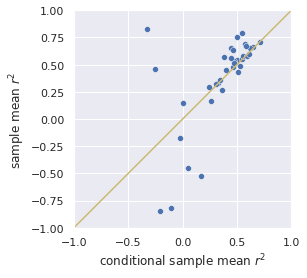

In [85]:
sns.set_theme(style='darkgrid')
plt.xlim(-1, 1)
plt.ylim(-1, 1)
lo, hi = -1, 1
plt.plot([lo, hi], [lo, hi], '-y')
g = sns.scatterplot(data=sample_vs_cond, y='sample mean $r^2$', x='conditional sample mean $r^2$')
g.set_aspect('equal', adjustable='box')

In [23]:
y_mean = data['iwi'].mean()


0.6799164847436557

In [ ]:
get_r2 = lambda g: scipy.stats.pearsonr(g['iwi'], g['y_i'])[0] ** 2

for fold_config in results_dict:
    for model_name in results_dict[fold_config]:
        model_r2s = results_dict[fold_config][model_name].groupby('fold').apply(get_fold_r2)

In [116]:
data.groupby('country')['iwi'].std()

country
comoros    12.379336
Name: iwi, dtype: float64

## Investigate bad values

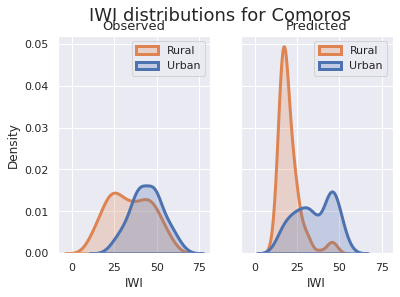

In [114]:
data = results_dict['ooc']['bidirectional_resnet_lstm']
country = 'comoros'
data = data[data['country'] == country]

fig, (ax1, ax2) = plt.subplots(1, 2, sharey=True, sharex=True)

plt1 = sns.kdeplot(data=data, hue='rural', x='iwi', 
            legend=False, fill=True, linewidth=3, ax=ax1)

ax1.set_xlabel('IWI')
ax1.set_title('Observed')
ax1.legend(['Rural', 'Urban'])

sns.kdeplot(data=data, hue='rural', x='y_i', 
            legend=False, fill=True, linewidth=3, ax=ax2)

ax2.set_xlabel('IWI')
ax2.set_title('Predicted')
ax2.legend(['Rural', 'Urban'])
plt.suptitle('IWI distributions for ' + country.capitalize())
plt.show()

In [77]:
data = results_dict['ooc']['bidirectional_resnet_lstm']
country = 'comoros'
data = data[data['country'] == country]

rural_data = data[data['rural'] == 1]
urban_data = data[data['rural'] == 0]
print(country.capitalize())
print('Rural:', r2_score(rural_data['iwi'], rural_data['y_i']))
print('Urban:', r2_score(urban_data['iwi'], urban_data['y_i']))

Comoros
Rural: -1.103354500325454
Urban: -1.9552726129175309


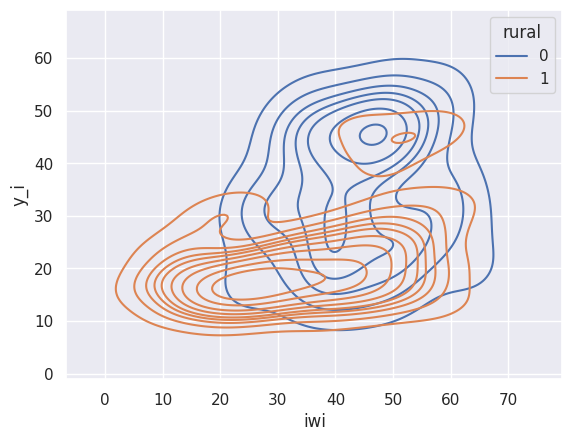

In [68]:
sns.kdeplot(data=data, x="iwi", y="y_i", hue="rural")
#plt.legend(['Rural', 'Urban'])
plt.show()

In [ ]:
urban_indices = df['rural'] == 0
sns.displot(data=df, hue='rural', x='iwi', kind='kde', 
            legend=False, fill=True, linewidth=3)

plt.xlabel('IWI')
plt.title('Distributions of IWI values')
plt.legend(['Rural', 'Urban'])
plt.show()

Mean : 0.6584004954197229
Median: 0.6668898440722723
Max : 0.8359341144560746
Min: 0.30701038012933973


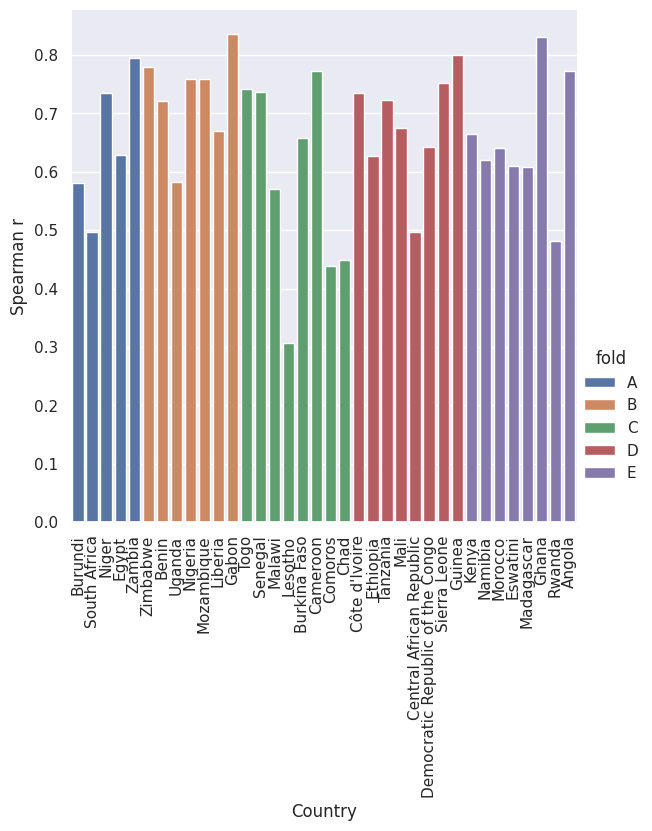

In [12]:
from scipy.stats import spearmanr

data = results_dict['ooc']['bidirectional_resnet_lstm']
# data = results_dict['ooc']['resnet']
country_r2s = data.groupby('name').apply(lambda g: spearmanr(g['iwi'], g['y_i'])[0]).reset_index()
country_folds = data.groupby('name').first()['fold']
country_r2s['fold'] = country_r2s['name'].apply(lambda country: country_folds[country])

sns.set_theme(style='darkgrid')
# Draw a nested barplot by species and sex
g = sns.catplot(
    data=country_r2s.sort_values('fold'), kind='bar',
    x='name', y=0, height=6, hue='fold', dodge=False
)

g.set_axis_labels('Country', 'Spearman r')
g.set_xticklabels(rotation=90)
print('Mean :', country_r2s[0].mean())
print('Median:', country_r2s[0].median())
print('Max :', country_r2s[0].max())
print('Min:', country_r2s[0].min())

In [ ]:
Mean : 0.6584004954197229
Median: 0.6668898440722723
Max : 0.8359341144560746
Min: 0.30701038012933973
    
Mean : 0.6285855723663348
Median: 0.652138170211793
Max : 0.8070488115485882
Min: 0.33131819023004766

### Plot best clusters

Resnet, Incountry
country        kenya
year            2003
iwi        16.198808
error       0.000078
Name: 24056, dtype: object


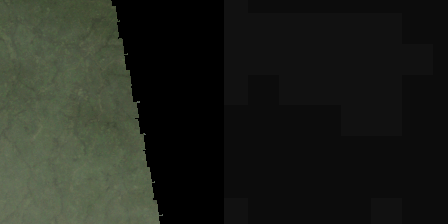

country     tanzania
year            2017
iwi        17.101805
error       0.000246
Name: 51240, dtype: object


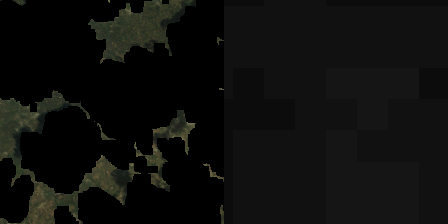

country     cameroon
year            2018
iwi        60.448945
error       0.000275
Name: 6772, dtype: object


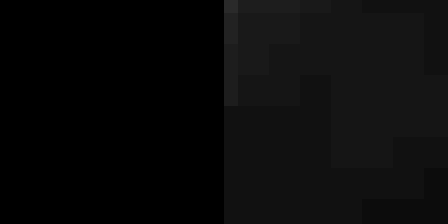

country       ghana
year           1999
iwi        21.04543
error      0.000508
Name: 20096, dtype: object


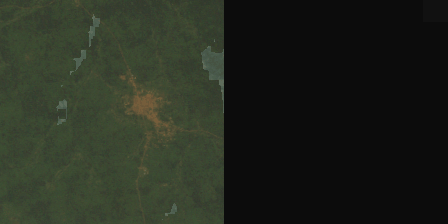

country     zimbabwe
year            2015
iwi        16.930499
error       0.000653
Name: 56991, dtype: object


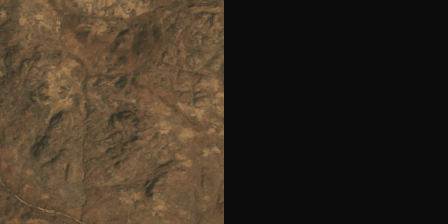

Bidirectional resnet lstm, Incountry
country      liberia
year            2013
iwi        11.030872
error       0.000215
Name: 28215, dtype: object


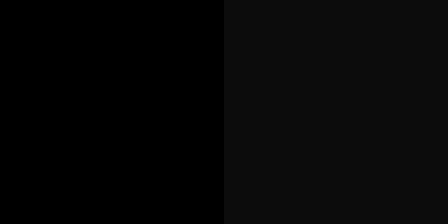

country        kenya
year            2003
iwi        16.232509
error       0.000402
Name: 24204, dtype: object


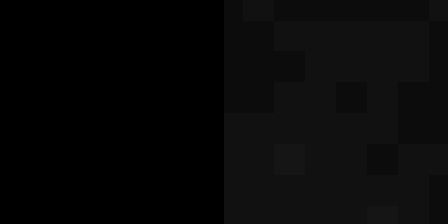

country       guinea
year            2005
iwi        14.585646
error       0.000684
Name: 22309, dtype: object


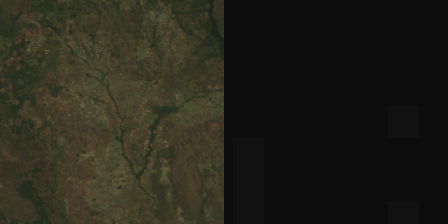

country         togo
year            2014
iwi        46.607458
error       0.001013
Name: 51926, dtype: object


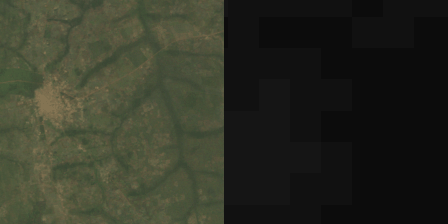

country       uganda
year            2009
iwi        18.291159
error       0.001077
Name: 52732, dtype: object


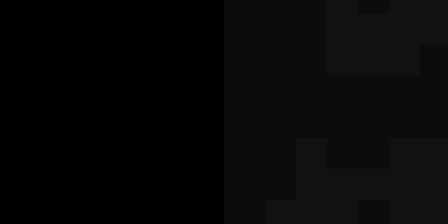

Bidirectional resnet lstm 10, Incountry
country        egypt
year            2008
iwi        70.410196
error        0.00004
Name: 14883, dtype: object


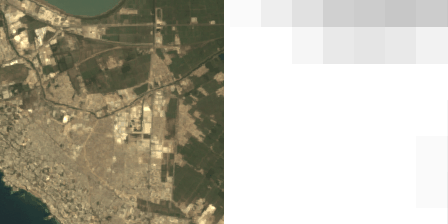

country       angola
year            2015
iwi        33.691176
error        0.00023
Name: 421, dtype: object


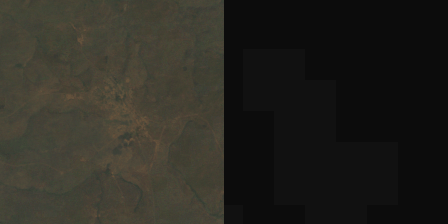

country     tanzania
year            2007
iwi        13.537237
error       0.000361
Name: 49218, dtype: object


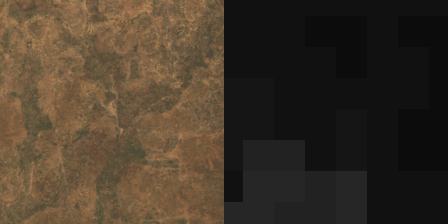

country    madagascar
year             2016
iwi         40.429262
error        0.000426
Name: 29764, dtype: object


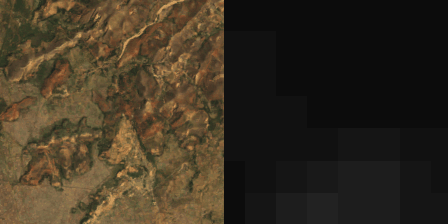

country       uganda
year            2009
iwi        28.003374
error       0.000444
Name: 52661, dtype: object


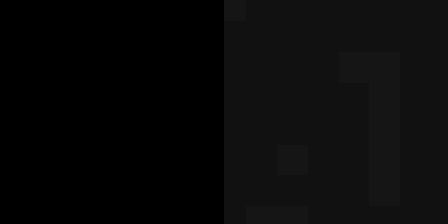

Resnet, OOC
country       ghana
year           2008
iwi        37.52471
error      0.000296
Name: 21012, dtype: object


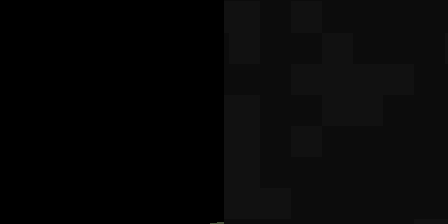

country        egypt
year            2000
iwi        49.659059
error       0.000856
Name: 10915, dtype: object


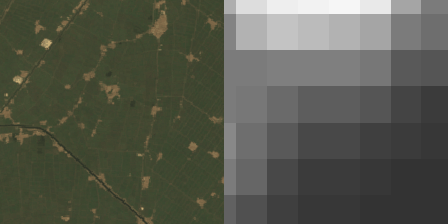

country        ghana
year            2003
iwi        14.671978
error       0.000874
Name: 20553, dtype: object


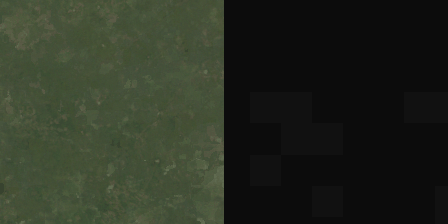

country        ghana
year            2019
iwi        43.775328
error       0.000914
Name: 21659, dtype: object


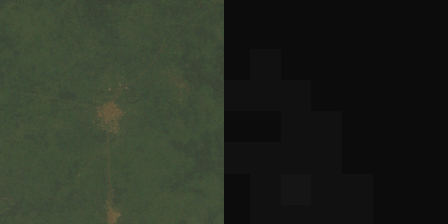

country      nigeria
year            2018
iwi        17.042039
error       0.001023
Name: 41345, dtype: object


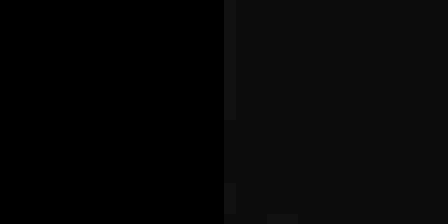

Bidirectional resnet lstm, OOC
country     zimbabwe
year            1999
iwi        14.053583
error       0.000238
Name: 55933, dtype: object


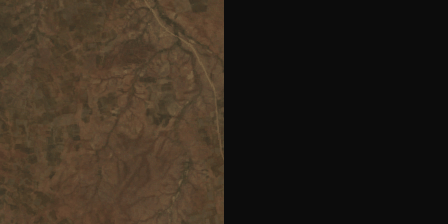

country     cameroon
year            2011
iwi        15.689849
error       0.000256
Name: 6395, dtype: object


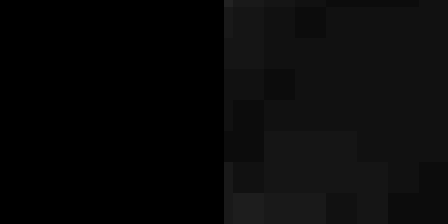

country        egypt
year            1995
iwi        60.205492
error       0.000412
Name: 10469, dtype: object


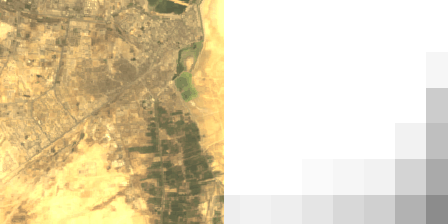

country     tanzania
year            2011
iwi        37.214667
error       0.000503
Name: 49913, dtype: object


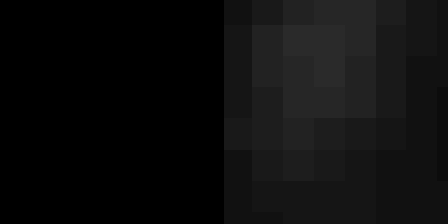

country        ghana
year            2016
iwi        46.508274
error       0.000516
Name: 21555, dtype: object


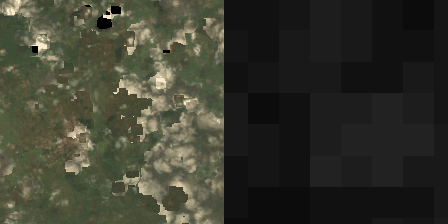

Bidirectional resnet lstm 10, OOC
country     ethiopia
year            2016
iwi        57.519406
error       0.000124
Name: 18562, dtype: object


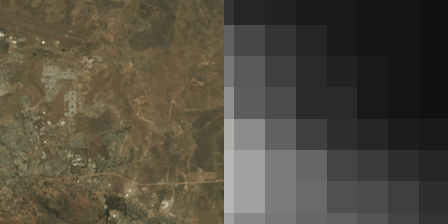

country       egypt
year           2005
iwi        67.96848
error       0.00027
Name: 13681, dtype: object


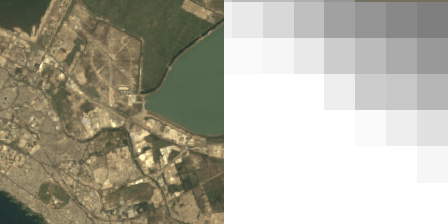

country       rwanda
year            2008
iwi        18.164412
error        0.00035
Name: 43051, dtype: object


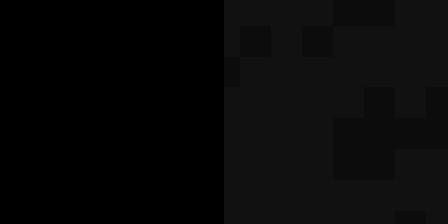

country       malawi
year            2015
iwi        18.970092
error       0.000365
Name: 32679, dtype: object


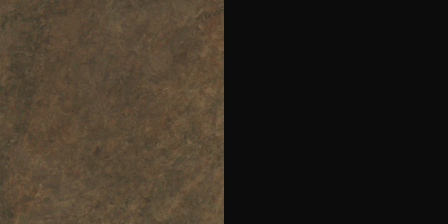

country    democratic_republic_of_congo
year                               2007
iwi                           13.721164
error                          0.000461
Name: 8463, dtype: object


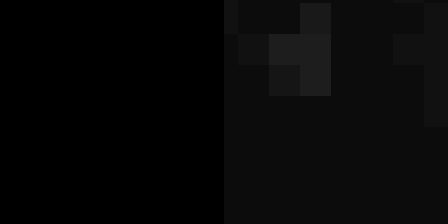

Resnet, OOTS
country     tanzania
year            1999
iwi        14.428745
error       0.000034
Name: 48880, dtype: object


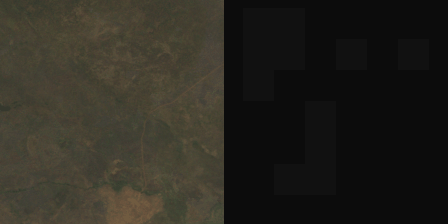

country    madagascar
year             2016
iwi         16.760355
error        0.000101
Name: 30067, dtype: object


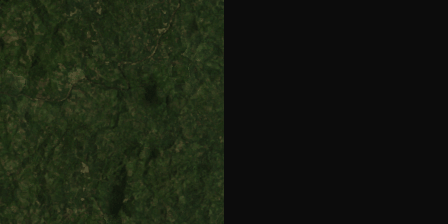

country    madagascar
year             2009
iwi         16.748178
error        0.000131
Name: 28992, dtype: object


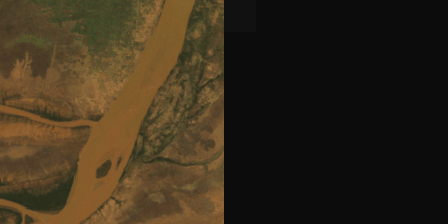

country      burundi
year            2010
iwi        15.917547
error       0.000422
Name: 4687, dtype: object


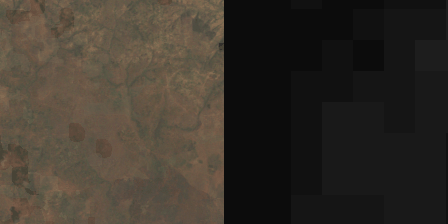

country        kenya
year            2003
iwi        44.531866
error       0.000616
Name: 23854, dtype: object


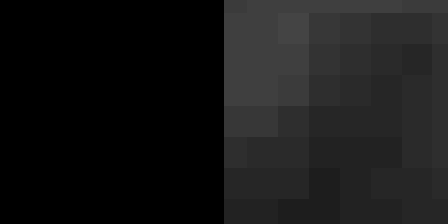

Bidirectional resnet lstm, OOTS
country        benin
year            2012
iwi        18.856355
error       0.000561
Name: 1894, dtype: object


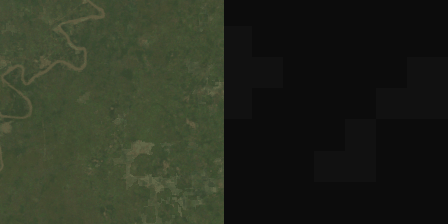

country       zambia
year            2013
iwi        32.438881
error       0.000731
Name: 54632, dtype: object


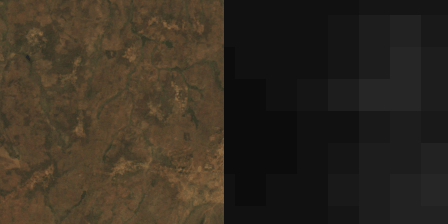

country      zambia
year           2014
iwi        22.15445
error      0.001312
Name: 55051, dtype: object


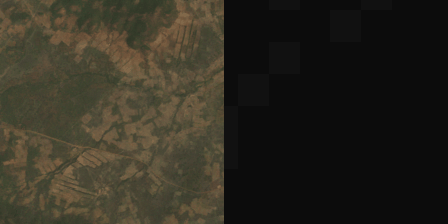

country      namibia
year            2007
iwi        14.771506
error       0.001443
Name: 37452, dtype: object


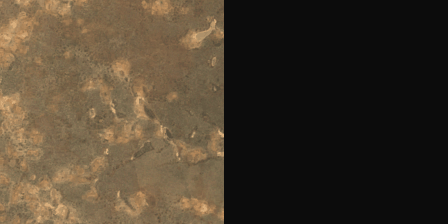

country       uganda
year            2016
iwi        17.305213
error       0.001746
Name: 53699, dtype: object


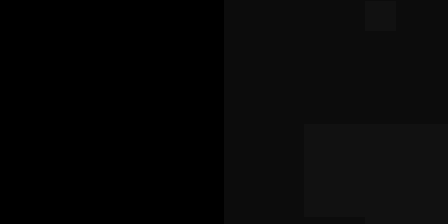

Bidirectional resnet lstm 10, OOTS
country       malawi
year            2015
iwi        15.820718
error       0.000406
Name: 32405, dtype: object


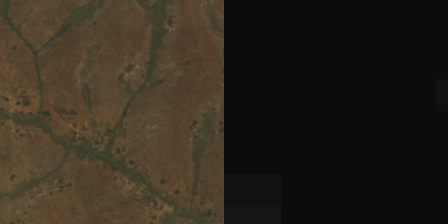

country     cameroon
year            2018
iwi        17.285588
error       0.000432
Name: 6862, dtype: object


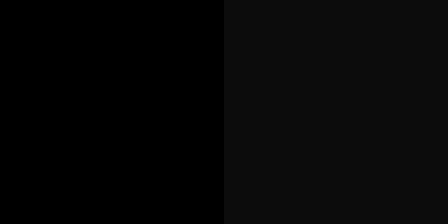

country     cameroon
year            2004
iwi        17.491914
error       0.000762
Name: 5719, dtype: object


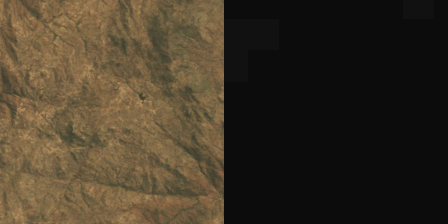

country         mali
year            2006
iwi        13.805191
error       0.000961
Name: 34295, dtype: object


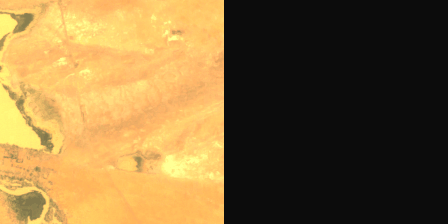

country    ethiopia
year           2005
iwi        8.619334
error       0.00117
Name: 17731, dtype: object


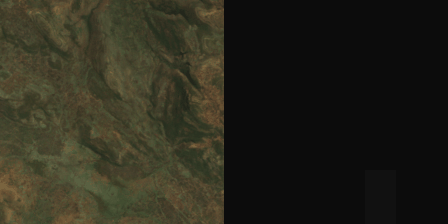

In [109]:
import data_handling

gif_dir_name = 'most_improved_gifs'
os.mkdir(gif_dir_name)

files = []

for fold_config in results_dict:
    for model_name in results_dict[fold_config]:
        results_df = results_dict[fold_config][model_name]
        # Get 5 best
        best_files = results_df.sort_values('error', ascending=True)['file'].values[:5]
        ds = data_handling.get_inference_dataset(best_files, batch_size=0, normalize=False, labeled=False)
        fold_config_name = fold_config.capitalize() if len(fold_config) > 4 else fold_config.upper()
        model_name = model_name.replace('_', ' ').capitalize()
        title = model_name + ', ' + fold_config_name
        print(title)
        for x in ds.as_numpy_iterator():
            i = x['sample_index']
            print(results_df.loc[i, ['country', 'year', 'iwi', 'error']])
            save_file_name = os.path.join(gif_dir_name, str(i) + '.gif')
            files.append(save_file_name)
            to_gif(x['model_input'], include_nl=True) # , show=False, save_file_name=save_file_name)

shutil.rmtree(gif_dir_name)

In [56]:
from IPython.display import display, Markdown

markdown = ' \
| Col header A                  | Col header B                  | \n \
|:-----------------------------:|:-----------------------------:| \n \
| <img src="most_improved_gifs/24056.gif">  | <img src="most_improved_gifs/24056.gif">  | \n \
| <img src="most_improved_gifs/24056.gif">  | <img src="most_improved_gifs/24056.gif">  | \n \
'

chart = Markdown(markdown)
display(chart)

 | Col header A                  | Col header B                  | 
 |:-----------------------------:|:-----------------------------:| 
 | <img src="most_improved_gifs/24056.gif">  | <img src="most_improved_gifs/24056.gif">  | 
 | <img src="most_improved_gifs/24056.gif">  | <img src="most_improved_gifs/24056.gif">  | 
 

In [52]:
display(files[0], files[1])

'most_improved_gifs/24056.gif'

'most_improved_gifs/51240.gif'

<img src="/cephyr/users/markpett/Alvis/satellite_poverty_prediction/evaluate_results/image.gif" width="40" height="40" />

<img src="/tmp/image.gif" width="40" height="40" />

In [27]:
!pwd

/cephyr/users/markpett/Alvis/satellite_poverty_prediction


<img src="image.gif" width="200" height="200"/>

In [26]:
!mv /cephyr/users/markpett/Alvis/satellite_poverty_prediction/evaluate_results/image.gif /tmp/image.gif

### End plot best clusters

## Where does the model struggle?

### Model performance compared to other scalar variables

In [102]:
def plot_prediction_error(df, x='iwi', x_bins=None, ax=None, title='Prediction error'):
    if ax is None:
        fig, ax = plt.subplots(1, 1)
    sns.regplot(data=df[df['rural'] == 0], x=x, y='error', x_bins=x_bins, fit_reg=None, ci=None, ax=ax)
    sns.regplot(data=df[df['rural'] == 1], x=x, y='error', x_bins=x_bins, fit_reg=None, ci=None, ax=ax)
    ax.set(xlabel=x, ylabel='Prediction error')
    ax.set_title(title)
    ax.legend(['Urban', 'Rural']) # , loc='upper left')
    ax.grid(True)

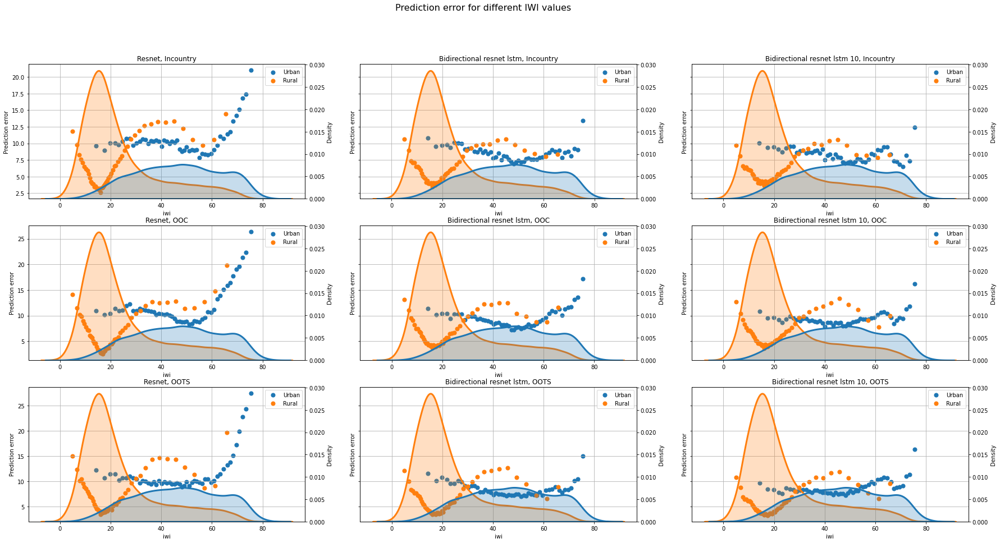

In [103]:
fig, axs = plt.subplots(3, 3, figsize=(30, 15), sharey='row')

for i, fold_config in enumerate(results_dict):
    for j, model_name in enumerate(results_dict[fold_config]):
        results_df = results_dict[fold_config][model_name]
        fold_config_name = 'Incountry' if i == 0 else fold_config.upper()
        model_name = model_name.replace('_', ' ').capitalize()
        title = model_name + ', ' + fold_config_name
        
        ax = axs[i, j]
        ax2 = ax.twinx()
        
        sns.kdeplot(data=results_df, hue='rural', x='iwi', 
            legend=False, fill=True, linewidth=3, ax=ax2)
        
        plot_prediction_error(results_df, x='iwi', x_bins=50, ax=ax, title=title)
        
fig.suptitle('Prediction error for different IWI values', fontsize=16)
plt.show()

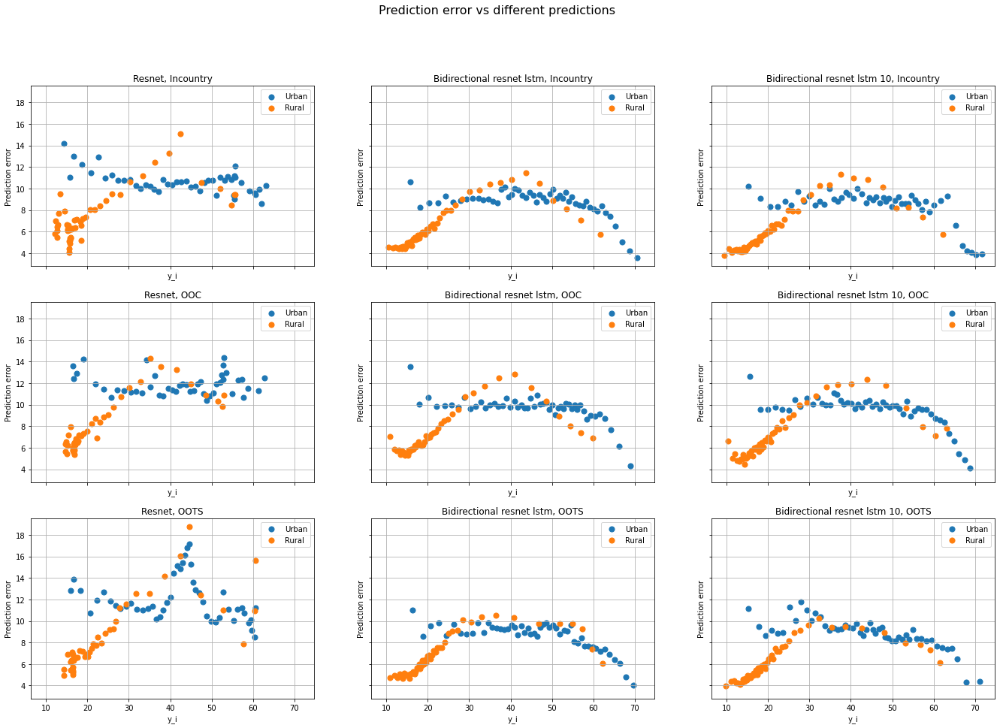

In [73]:
fig, axs = plt.subplots(3, 3, figsize=(23, 15), sharey=True, sharex=True)

for i, fold_config in enumerate(results_dict):
    for j, model_name in enumerate(results_dict[fold_config]):
        results_df = results_dict[fold_config][model_name]
        fold_config_name = 'Incountry' if i == 0 else fold_config.upper()
        model_name = model_name.replace('_', ' ').capitalize()
        title = model_name + ', ' + fold_config_name
        plot_prediction_error(results_df, x='y_i', x_bins=50, ax=axs[i, j], title=title)
        
fig.suptitle('Prediction error vs different predictions', fontsize=16)
plt.show()

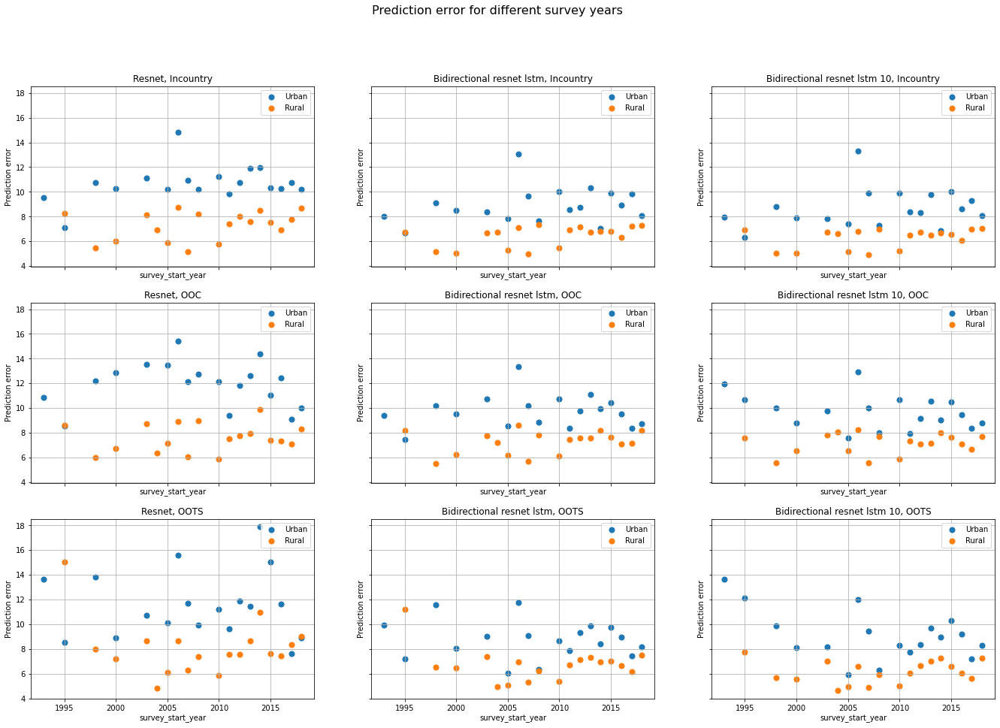

In [74]:
fig, axs = plt.subplots(3, 3, figsize=(23, 15), sharey=True, sharex=True)

for i, fold_config in enumerate(results_dict):
    for j, model_name in enumerate(results_dict[fold_config]):
        results_df = results_dict[fold_config][model_name]
        fold_config_name = 'Incountry' if i == 0 else fold_config.upper()
        model_name = model_name.replace('_', ' ').capitalize()
        title = model_name + ', ' + fold_config_name
        plot_prediction_error(results_df, x='survey_start_year', x_bins=30, ax=axs[i, j], title=title)
        
fig.suptitle('Prediction error for different survey years', fontsize=16)
plt.show()

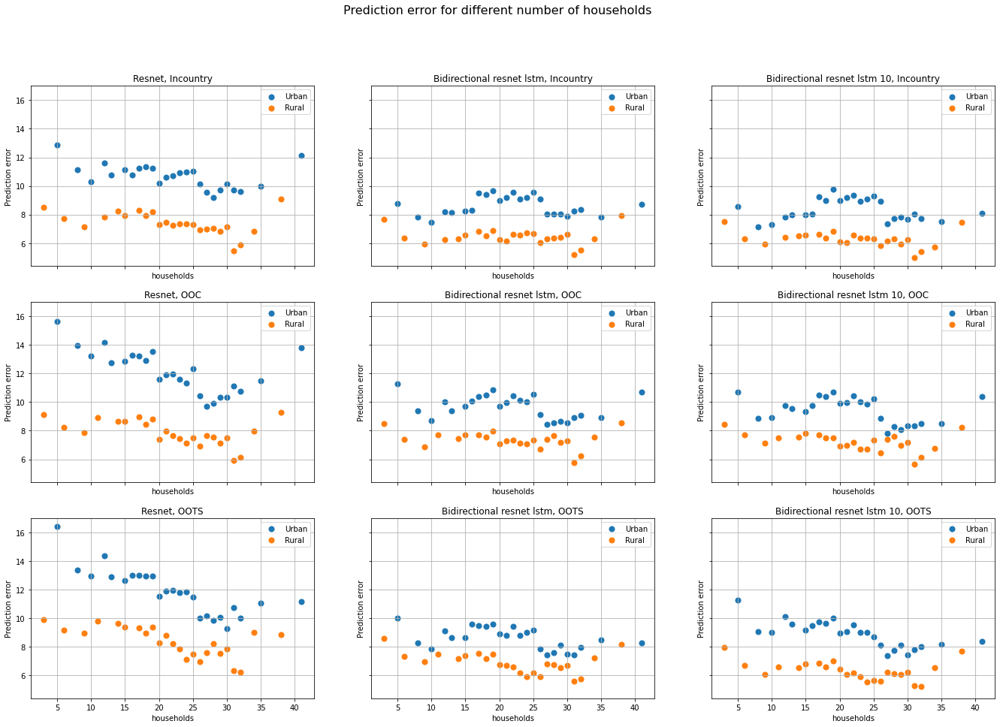

In [79]:
fig, axs = plt.subplots(3, 3, figsize=(23, 15), sharey=True, sharex=True)

for i, fold_config in enumerate(results_dict):
    for j, model_name in enumerate(results_dict[fold_config]):
        results_df = results_dict[fold_config][model_name]
        fold_config_name = 'Incountry' if i == 0 else fold_config.upper()
        model_name = model_name.replace('_', ' ').capitalize()
        title = model_name + ', ' + fold_config_name
        plot_prediction_error(results_df, x='households', x_bins=30, ax=axs[i, j], title=title)
        
fig.suptitle('Prediction error for different number of households', fontsize=16)
plt.show()

### Best clusters

In [210]:
n = len(data)
best_10 = data.sort_values('error')[:int(n/10)]
worst_10 = data.sort_values('error', ascending=False)[:int(n/10)]

best_10['best_10'] = True
worst_10['best_10'] = False

#.fillna(False,inplace=True)

#best_worst_df = pd.concat([best_10, worst_10])
#best_worst_df['best'].value_counts()

In [20]:
data = results_dict['ooc']['bidirectional_resnet_lstm']
ranked_df = data.sort_values('error')
n = len(data)
best_5_counts = ranked_df[:int(n/20)].groupby(['name']).size()
worst_5_counts = ranked_df[-int(n/20):].groupby(['name']).size()
best_10_counts = ranked_df[:int(n/10)].groupby(['name']).size()
worst_10_counts = ranked_df[-int(n/10):].groupby(['name']).size()

best_5 = []
worst_5 = []
ratio_5 = []
best_10 = []
worst_10 = []
ratio_10 = []

countries = data['name'].unique()
for country in countries:
    n_country = sum(data['name'] == country)
    
    best_5_count = best_5_counts[country] if best_5_counts[country] else 0
    best_5_count /= n_country
    
    worst_5_count = worst_5_counts[country] if worst_5_counts[country] else 0
    worst_5_count /= n_country
    
    best_10_count = best_10_counts[country] if best_10_counts[country] else 0
    best_10_count /= n_country
    
    worst_10_count = worst_10_counts[country] if worst_10_counts[country] else 0
    worst_10_count /= n_country
    
    
    best_5.append(best_5_count)
    worst_5.append(-worst_5_count)
    ratio_5.append(best_5_count - worst_5_count)
    best_10.append(best_10_count)
    worst_10.append(-worst_10_count)
    ratio_10.append(best_10_count - worst_10_count)
    
best_worst_df = pd.DataFrame({
    'country': countries, 
    'best_5': best_5, 
    'worst_5': worst_5, 
    'ratio_5': ratio_5,
    'best_10': best_10, 
    'worst_10': worst_10, 
    'ratio_10': ratio_10
}, index=countries).sort_values('ratio_10', ascending=False)
best_worst_df

,country,best_5,worst_5,ratio_5,best_10,worst_10,ratio_10
Rwanda,Rwanda,0.084273,-0.016617,0.067656,0.148961,-0.040356,0.108605
Burundi,Burundi,0.068262,-0.018617,0.049645,0.142730,-0.039894,0.102837
Mali,Mali,0.065945,-0.007728,0.058217,0.127769,-0.028336,0.099433
Guinea,Guinea,0.058916,-0.010212,0.048704,0.125687,-0.033778,0.091909
Sierra Leone,Sierra Leone,0.054827,-0.009535,0.045292,0.105483,-0.023242,0.082241
Malawi,Malawi,0.078832,-0.032663,0.046168,0.154837,-0.072864,0.081972
Benin,Benin,0.061988,-0.015789,0.046199,0.123392,-0.050877,0.072515
Burkina Faso,Burkina Faso,0.062644,-0.025862,0.036782,0.130460,-0.061494,0.068966
Uganda,Uganda,0.064715,-0.029789,0.034926,0.120699,-0.055470,0.065229
Madagascar,Madagascar,0.057946,-0.021228,0.036718,0.123924,-0.060815,0.063110


/local/tmp.621060/ipykernel_2592750/849733181.py:17: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([int(abs(100 * tick)) for tick in ticks])


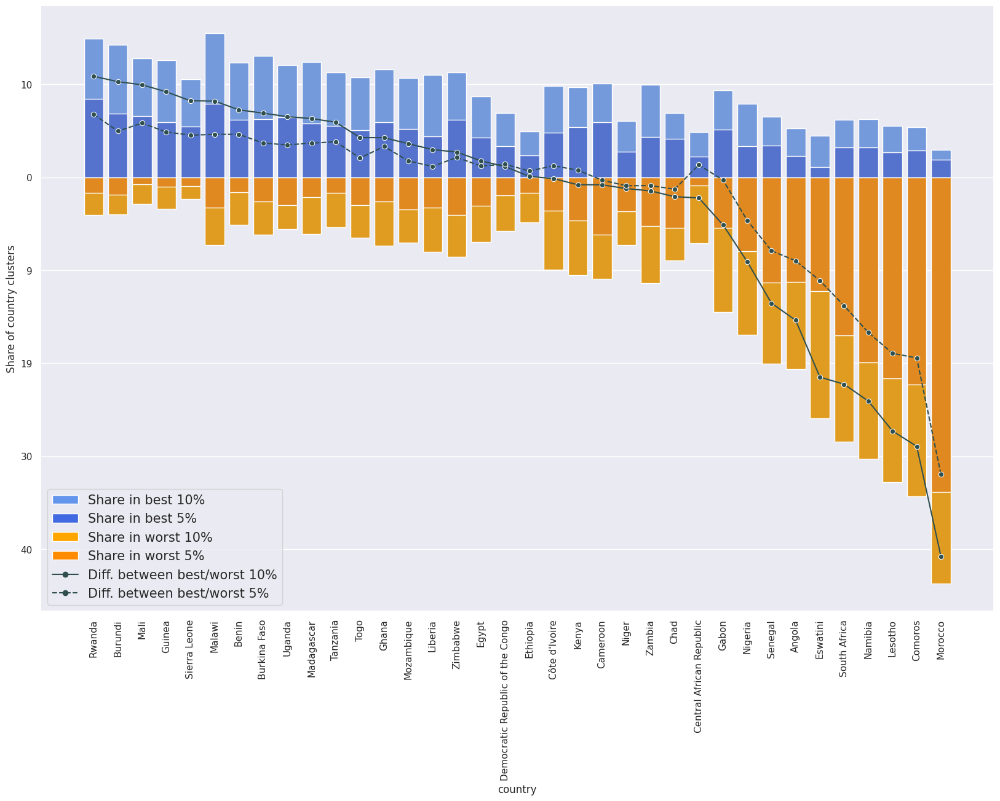

In [21]:
from matplotlib.patches import Patch
from matplotlib.lines import Line2D

fig, ax = plt.subplots(1, 1, figsize=(20, 12.8))
sns.barplot(data=best_worst_df, x='country', y='best_10', color='cornflowerblue', ax=ax)
sns.barplot(data=best_worst_df, x='country', y='best_5', color='royalblue', ax=ax)
sns.barplot(data=best_worst_df, x='country', y='worst_10', color='orange', ax=ax)
sns.barplot(data=best_worst_df, x='country', y='worst_5', color='darkorange', ax=ax)
sns.lineplot(data=best_worst_df, x='country', y='ratio_10', marker='o', color='darkslategray')
sns.lineplot(data=best_worst_df, x='country', y='ratio_5', marker='o', color='darkslategray', linestyle='dashed')
ax.set_ylabel('Share of country clusters')

# ax.bar_label(ax.containers[2], padding=8, rotation=90)

ticks =  ax.get_yticks()
# set labels to absolute values and with integer representation
ax.set_yticklabels([int(abs(100 * tick)) for tick in ticks])

legend_elements = [Patch(facecolor='cornflowerblue', label='Share in best 10%'),
                   Patch(facecolor='royalblue', label='Share in best 5%'),
                   Patch(facecolor='orange', label='Share in worst 10%'),
                   Patch(facecolor='darkorange', label='Share in worst 5%'),
                   Line2D([0], [0], marker='o', color='darkslategray', label='Diff. between best/worst 10%'),
                   Line2D([0], [0], marker='o', color='darkslategray', linestyle='dashed', label='Diff. between best/worst 5%')]

ax.legend(handles=legend_elements, loc='lower left', prop={'size': 15})
ax.tick_params(axis='x', rotation=90)
plt.show()

## Feature importance for prediction error

What features are indicative of bad predictions?

In [38]:
from sklearn import preprocessing

min_max_scaler = preprocessing.MinMaxScaler()

feature_names = ['year', 'lat', 'lon', 'households', 'rural', 'iwi']
X = min_max_scaler.fit_transform(data[feature_names])
y = data['error'].values

In [43]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

In [ ]:
from sklearn.ensemble import RandomForestRegressor

forest = RandomForestRegressor()
# fit the model
forest.fit(X_train, y_train)

In [64]:
print('The r^2 for predicting error: {:.2f}'.format(forest.score(X_test, y_test)))

The r^2 for predicting error: 0.51


In [46]:
from sklearn.inspection import permutation_importance
import time

start_time = time.time()
result = permutation_importance(
    forest, X_test, y_test, n_repeats=10, random_state=42, n_jobs=2
)
elapsed_time = time.time() - start_time
print(f"Elapsed time to compute the importances: {elapsed_time:.3f} seconds")

forest_importances = pd.Series(result.importances_mean, index=feature_names)

Elapsed time to compute the importances: 13.497 seconds


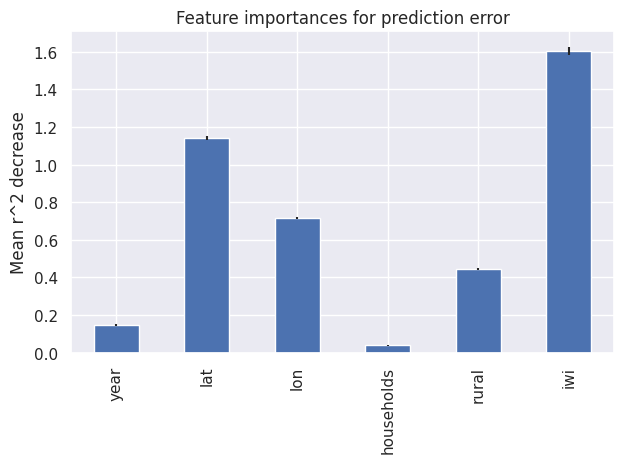

In [65]:
fig, ax = plt.subplots()
forest_importances.plot.bar(yerr=result.importances_std, ax=ax)
ax.set_title("Feature importances for prediction error")
ax.set_ylabel("Mean r^2 decrease")
fig.tight_layout()
plt.show()

---

In [210]:
data.groupby('country').first()['fold'].sort_values()

country
burundi                         A
south_africa                    A
niger                           A
egypt                           A
zambia                          A
zimbabwe                        B
benin                           B
uganda                          B
nigeria                         B
mozambique                      B
gabon                           B
liberia                         B
togo                            C
senegal                         C
malawi                          C
lesotho                         C
burkina_faso                    C
cameroon                        C
comoros                         C
chad                            C
democratic_republic_of_congo    D
guinea                          D
ethiopia                        D
mali                            D
tanzania                        D
central_african_republic        D
sierra_leone                    D
ivory_coast                     D
kenya                           E
namibi

In [5]:
five frame incountry:
fold
A    0.712743
B    0.792361
C    0.787387
D    0.688255
E    0.648448
dtype: float64
    
single frame incountry:
fold
A    0.669447
B    0.608622
C    0.660870
D    0.649871
E    0.581360
dtype: float64
    
five frame OOC:
fold
A    0.729499
B    0.588974
C    0.389554
D    0.644030
E    0.550382
dtype: float64
    
single frame OOC:
fold
A    0.477790
B    0.519523
C    0.374199
D    0.516820
E    0.485401
dtype: float64
    
five frame OOTS:
fold
A    0.655653
B    0.830634
C    0.667764
D    0.757378
E    0.694342
dtype: float64
    
single frame OOTS:
fold
A    0.470302
B    0.724895
C    0.539603
D    0.491172
E    0.599064
dtype: float64

,y_0,y_1,y_2,y_3,y_4,y_5,y_6,y_7,y_8,y_9,y_i,fold
Unnamed: 0,,,,,,,,,,,,
0,0.121460,0.130127,0.126099,0.132202,0.129028,0.142993,0.135651,0.142131,0.156433,0.165405,0.142993,B
1,0.174438,0.190735,0.191772,0.222839,0.245630,0.304639,0.362305,0.371419,0.447266,0.489746,0.304639,A
2,0.140991,0.150146,0.147705,0.158539,0.172778,0.186230,0.197784,0.222209,0.255249,0.280029,0.186230,B
3,0.151855,0.198364,0.198853,0.203613,0.251489,0.287109,0.356689,0.351725,0.431396,0.458496,0.287109,A
4,0.093628,0.108948,0.098267,0.102463,0.103101,0.104016,0.125122,0.124105,0.156494,0.227539,0.104016,C
...,...,...,...,...,...,...,...,...,...,...,...,...
57190,0.172363,0.190430,0.158000,0.155640,0.167261,0.172192,0.166351,0.184977,0.207764,0.230469,0.207764,E
57191,0.158325,0.160645,0.174276,0.173187,0.171313,0.176416,0.171875,0.185628,0.204285,0.230957,0.204285,A
57192,0.134521,0.132385,0.141602,0.131592,0.137012,0.135498,0.150665,0.154012,0.175354,0.197021,0.175354,E


In [4]:
results_df

,y_i,y_0,y_1,y_2,y_3,y_4,y_5,y_6,y_7,y_8,y_9,fold
Unnamed: 0,,,,,,,,,,,,
0,0.138428,0.210693,0.164673,0.165649,0.135742,0.136719,0.138428,0.167603,0.165894,0.201294,0.238281,B
1,0.268555,0.239624,0.221924,0.203979,0.199463,0.234863,0.268555,0.331787,0.383789,0.442383,0.476074,A
2,0.177246,0.222534,0.204712,0.182617,0.183594,0.191406,0.177246,0.186035,0.268799,0.283447,0.307617,B
3,0.317871,0.246216,0.280273,0.296875,0.272949,0.286865,0.317871,0.348145,0.377930,0.438721,0.457520,A
4,0.152344,0.186401,0.180542,0.163696,0.159302,0.162720,0.152344,0.169189,0.193115,0.197388,0.227905,C
...,...,...,...,...,...,...,...,...,...,...,...,...
57190,0.327637,0.300781,0.294922,0.300293,0.285645,0.285645,0.289795,0.282959,0.311523,0.327637,0.347412,E
57191,0.314209,0.236694,0.218506,0.230591,0.236328,0.243652,0.233887,0.266113,0.283447,0.314209,0.356201,A
57192,0.230103,0.241699,0.210571,0.193848,0.193359,0.192383,0.185059,0.207275,0.218628,0.230103,0.249878,E


<AxesSubplot:xlabel='y_i', ylabel='iwi'>

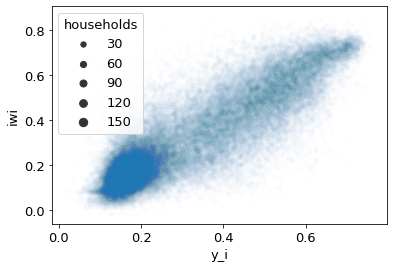

In [20]:
sns.scatterplot(data=df, x='y_i', y='iwi', alpha=0.01, size='households')

<AxesSubplot:xlabel='y_i', ylabel='iwi'>

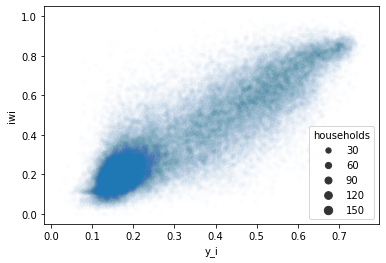

In [7]:
sns.scatterplot(data=df, x='y_i', y='iwi', alpha=0.01, size='households')

In [6]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scipy
import sklearn.metrics


def calc_score(labels, preds, metric, weights=None):
    '''
    See https://en.wikipedia.org/wiki/Pearson_correlation_coefficient#Weighted_correlation_coefficient
    for the weighted correlation coefficient formula.

    Args
    - labels: np.array, shape [N]
    - preds: np.array, shape [N]
    - score: str, one of ['r2', 'R2', 'mse', 'rank']
        - 'r2': (weighted) squared Pearson correlation coefficient
        - 'R2': (weighted) coefficient of determination
        - 'mse': (weighted) mean squared-error
        - 'rank': (unweighted) Spearman rank correlation coefficient
    - weights: np.array, shape [N]

    Returns: float
    '''
    if metric == 'r2':
        if weights is None:
            return scipy.stats.pearsonr(labels, preds)[0] ** 2
        else:
            mx = np.average(preds, weights=weights)
            my = np.average(labels, weights=weights)
            cov_xy = np.average((preds - mx) * (labels - my), weights=weights)
            cov_xx = np.average((preds - mx) ** 2, weights=weights)
            cov_yy = np.average((labels - my) ** 2, weights=weights)
            return cov_xy ** 2 / (cov_xx * cov_yy)
    elif metric == 'R2':
        return sklearn.metrics.r2_score(y_true=labels, y_pred=preds,
                                        sample_weight=weights)
    elif metric == 'mse':
        return np.average((labels - preds) ** 2, weights=weights)
    elif metric == 'rank':
        return scipy.stats.spearmanr(labels, preds)[0]
    else:
        raise ValueError(f'Unknown metric: "{metric}"')

In [7]:
def scatter_preds(labels, preds, by_name=None, by_col=None, ax=None,
                  title=None, figsize=(6, 6)):
    '''Creates a scatter plot of labels vs. preds, overlayed with regression line.

    Args
    - labels: np.array, shape [N]
    - preds: np.array, shape [N]
    - by_name: str, name of col
    - by_col: np.array, shape [N]
    - ax: matplotlib.axes.Axes
    - figsize: tuple of (width, height)
    '''
    data = {'IWI': labels, 'Predictions': preds}
    plt.rcParams.update({'font.size': 13})
    if by_name is not None:
        assert by_col is not None
        data[by_name] = by_col
    df = pd.DataFrame(data)
    if ax is None:
        fig, ax = plt.subplots(1, 1, figsize=figsize)

    # y=x
    lo, hi = min(min(labels), min(preds)) - 0.3, max(max(labels), max(preds)) + 0.3
    ax.plot([lo, hi], [lo, hi], '-y')

    # scatterplot
    sns.scatterplot(data=df, x='IWI', y='Predictions', hue=by_name, ax=ax, s=15,
                    linewidth=0)

    # regression line
    r2 = calc_score(labels=labels, preds=preds, metric='r2')
    m, b = np.polyfit(labels, preds, 1)
    ax.plot(labels, m * labels + b, ':k', label=f'$r^2={r2:.3g}$')

    ax.set_aspect('equal')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    ax.grid(True)

    if title is not None:
        ax.set_title(title)

In [10]:
df.sample(10)[['iwi', 'year', 'y_i', 'y_0', 'y_1', 'y_2', 'y_3', 'y_4',
       'y_5', 'y_6', 'y_7', 'y_8', 'y_9']]

,iwi,year,y_i,y_0,y_1,y_2,y_3,y_4,y_5,y_6,y_7,y_8,y_9
1145,0.324093,1996,0.235718,0.260742,0.251465,0.235718,0.253418,0.278320,0.299805,0.335205,0.350586,0.379883,0.441406
400,0.596035,2015,0.657227,0.265137,0.282227,0.302246,0.352783,0.418701,0.436523,0.506348,0.557617,0.657227,0.674805
17526,0.134265,2005,0.173096,0.214355,0.224121,0.235718,0.191162,0.181885,0.173096,0.184082,0.192871,0.215576,0.237671
20322,0.272852,2003,0.364014,0.306641,0.293945,0.268555,0.296875,0.364014,0.339600,0.396973,0.461914,0.482910,0.468262
33829,0.215402,2001,0.361572,0.269043,0.281250,0.289062,0.361572,0.397217,0.409668,0.421631,0.441406,0.423340,0.469238
18869,0.661363,2016,0.421631,0.246338,0.254883,0.269287,0.286865,0.300293,0.321777,0.369629,0.385498,0.421631,0.467041
12057,0.503147,2003,0.544922,0.361328,0.407959,0.462402,0.502930,0.544922,0.574219,0.618164,0.655762,0.742676,0.709961
48832,0.755217,2016,0.804688,0.617676,0.688965,0.756348,0.786133,0.791992,0.791992,0.794434,0.787598,0.804688,0.757324
7535,0.279573,2014,0.293945,0.231567,0.220215,0.214233,0.199829,0.233765,0.248291,0.259033,0.274902,0.293945,0.354248
9085,0.452139,1992,0.329834,0.329834,0.380859,0.428223,0.463623,0.503418,0.532227,0.573242,0.631836,0.729004,0.703125


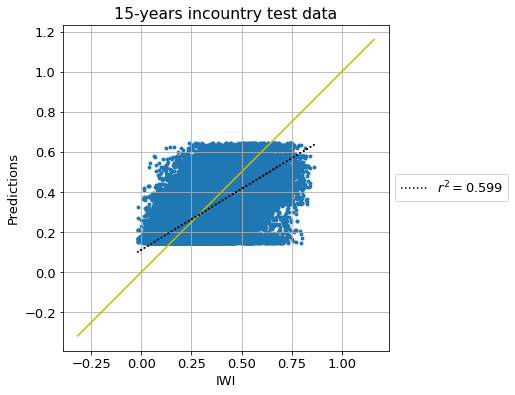

In [18]:
scatter_preds(df['iwi'], df['y_i'], title='15-years incountry test data')

In [20]:
ic_b = 0.747
ooc_b = 0.689
oots_b = 0.738

ic_r = 0.661
ooc_r = 0.599
oots_r = 0.577

print('Incountry:', (ic_b / ic_r - 1) * 100)
print('Ooc:', (ooc_b / ooc_r - 1) * 100)
print('Oots:', (oots_b / oots_r - 1) * 100)

Incountry: 13.010590015128587
Ooc: 15.02504173622703
Oots: 27.902946273830164


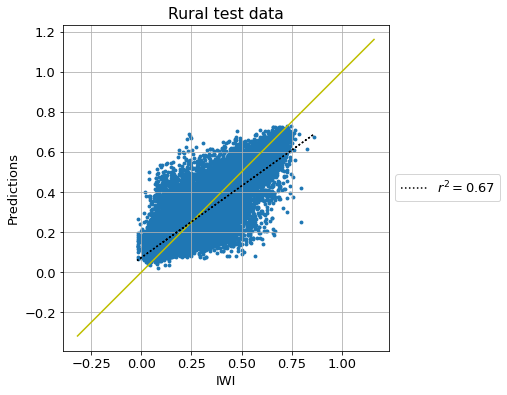

In [22]:
scatter_preds(df[df['rural'] == 1]['iwi'], df[df['rural'] == 1]['y_i'], title='Rural test data')

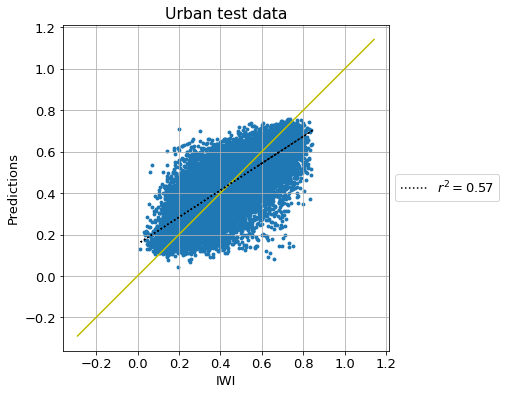

In [23]:
scatter_preds(df[df['rural'] == 0]['iwi'], df[df['rural'] == 0]['y_i'], title='Urban test data')

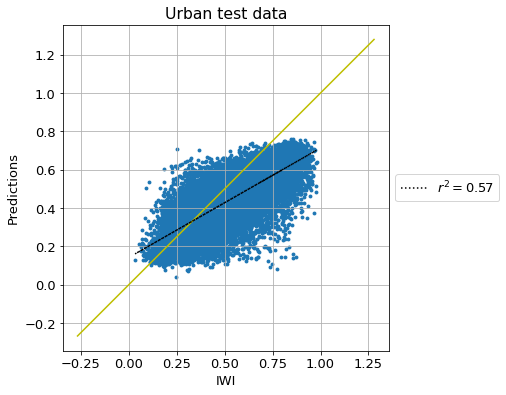

In [14]:
scatter_preds(df[df['rural'] == 0]['iwi'], df[df['rural'] == 0]['y_i'], title='Urban test data')

In [28]:
df['mse'] = (df['iwi'] - df['y_i']) ** 2

<AxesSubplot:xlabel='country'>

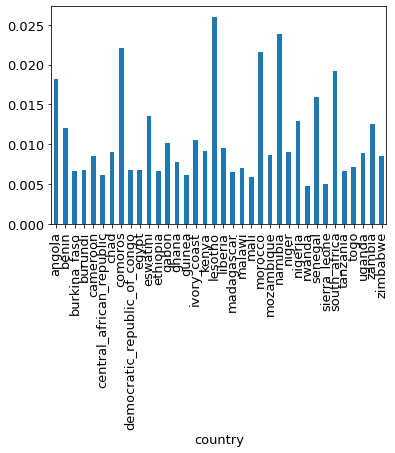

In [29]:
df.groupby('country')['mse'].mean().plot.bar()

## Over time evaluation

In [46]:
for fold in 'ABCDE':
    fold_data = data[data['fold'] == fold]
    print(fold, min(fold_data['survey_start_year']), max(fold_data['survey_start_year']))

A 1991 2003
B 2004 2008
C 2009 2012
D 2013 2015
E 2016 2019


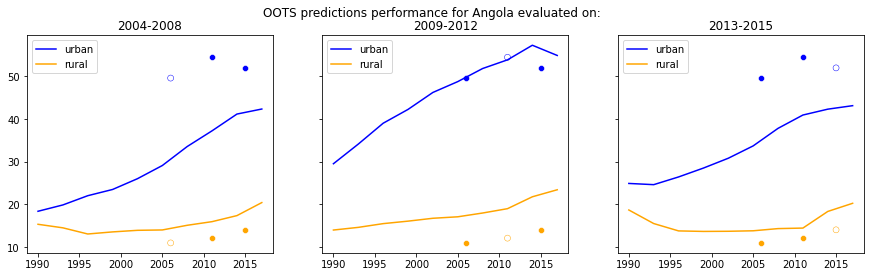

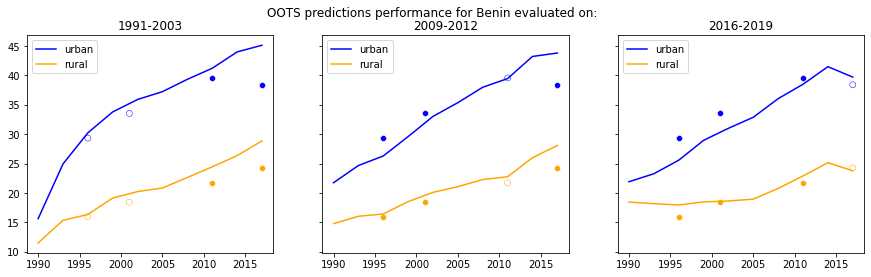

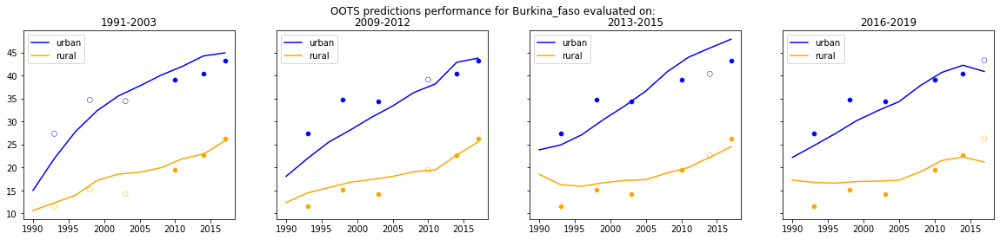

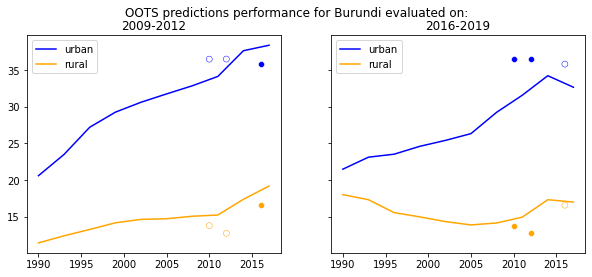

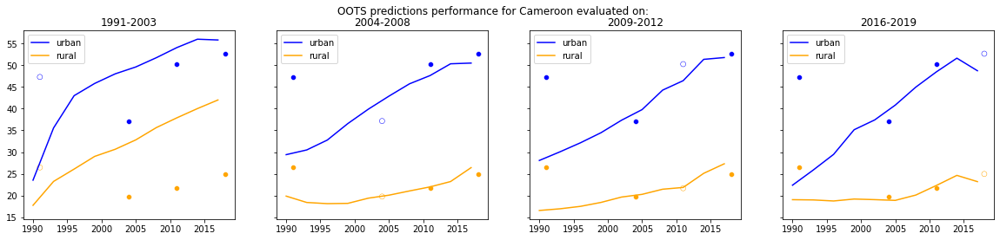

...

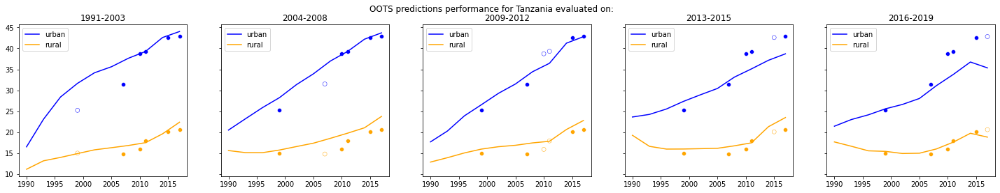

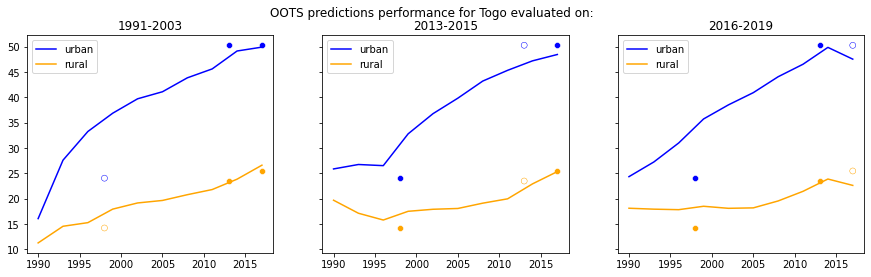

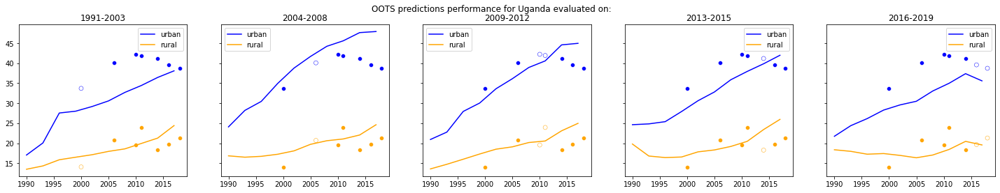

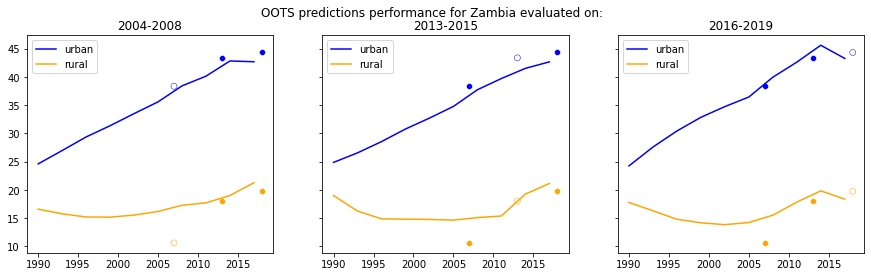

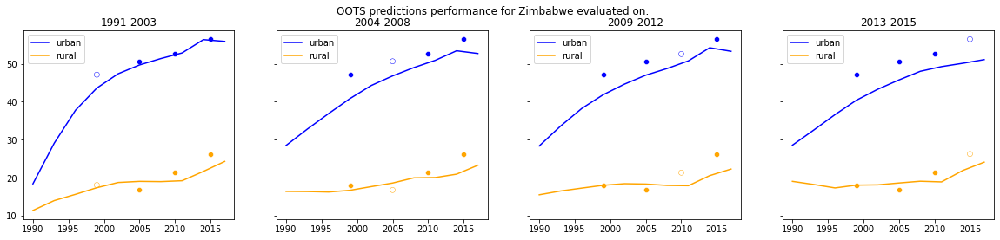

"\nplt1 = sns.kdeplot(data=data, hue='rural', x='iwi', \n            legend=False, fill=True, linewidth=3, ax=ax1)\n\nax1.set_xlabel('IWI')\nax1.set_title('Observed')\nax1.legend(['Rural', 'Urban'])\n\nsns.kdeplot(data=data, hue='rural', x='y_i', \n            legend=False, fill=True, linewidth=3, ax=ax2)\n\nax2.set_xlabel('IWI')\nax2.set_title('Predicted')\nax2.legend(['Rural', 'Urban'])\nplt.suptitle('IWI distributions for ' + country.capitalize())\nplt.show()\n"

In [49]:
data = results_dict['oots']['bidirectional_resnet_lstm_10']
countries = data['country'].unique()
pred_columns = ['y_0', 'y_1', 'y_2', 'y_3', 'y_4', 'y_5', 'y_6', 'y_7', 'y_8', 'y_9']

ranges = {
    'A': '1991-2003',
    'B': '2004-2008',
    'C': '2009-2012',
    'D': '2013-2015',
    'E': '2016-2019'
}

for country in countries:

    country_df = data[data['country'] == country]
    test_folds = country_df['fold'].unique()

    n_folds = len(test_folds)
    if n_folds < 2:
        continue
    fig, axs = plt.subplots(1, n_folds, sharey=True, sharex=True, figsize=(n_folds*5, 4))

    for ax, fold in zip(axs, test_folds):
        test_is = country_df['fold'] == fold
        train_df = country_df[~test_is]
        test_df = country_df[test_is]

        train_years = train_df['survey_start_year'].unique()
        test_years = test_df['survey_start_year'].unique()

        train_mean_urban = []
        train_mean_rural = []

        for year in train_years:
            cy_df = train_df[train_df['survey_start_year'] == year]
            train_mean_urban_iwi = cy_df[cy_df['rural'] == 0]['iwi'].mean()
            train_mean_rural_iwi = cy_df[cy_df['rural'] == 1]['iwi'].mean()
            train_mean_urban.append(train_mean_urban_iwi)
            train_mean_rural.append(train_mean_rural_iwi)

        test_mean_urban = []
        test_mean_rural = []

        for year in test_years:
            cy_df = test_df[test_df['survey_start_year'] == year]
            test_mean_urban_iwi = cy_df[cy_df['rural'] == 0]['iwi'].mean()
            test_mean_rural_iwi = cy_df[cy_df['rural'] == 1]['iwi'].mean()
            test_mean_urban.append(test_mean_urban_iwi)
            test_mean_rural.append(test_mean_rural_iwi)

        years = list(range(1990, 2020, 3))
        urban_preds = test_df[test_df['rural'] == 0][pred_columns].mean()
        rural_preds = test_df[test_df['rural'] == 1][pred_columns].mean()
        sns.lineplot(ax=ax, x=years, y=urban_preds, color='blue', label='urban')
        sns.lineplot(ax=ax, x=years, y=rural_preds, color='orange', label='rural')
        sns.scatterplot(ax=ax, x=train_years, y=train_mean_urban, color='blue')
        sns.scatterplot(ax=ax, x=train_years, y=train_mean_rural, color='orange')
        sns.scatterplot(ax=ax, x=test_years, y=test_mean_urban, color='blue', ec='blue', fc='none')
        sns.scatterplot(ax=ax, x=test_years, y=test_mean_rural, color='orange', ec='orange', fc='none')
        ax.set_title(ranges[fold])
    plt.suptitle('OOTS predictions performance for ' + country.capitalize() + ' evaluated on:')
    plt.show()
    
    
"""
plt1 = sns.kdeplot(data=data, hue='rural', x='iwi', 
            legend=False, fill=True, linewidth=3, ax=ax1)

ax1.set_xlabel('IWI')
ax1.set_title('Observed')
ax1.legend(['Rural', 'Urban'])

sns.kdeplot(data=data, hue='rural', x='y_i', 
            legend=False, fill=True, linewidth=3, ax=ax2)

ax2.set_xlabel('IWI')
ax2.set_title('Predicted')
ax2.legend(['Rural', 'Urban'])
plt.suptitle('IWI distributions for ' + country.capitalize())
plt.show()
"""

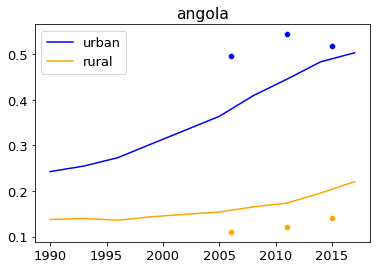

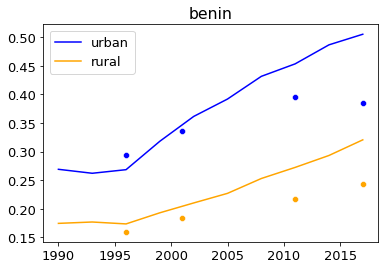

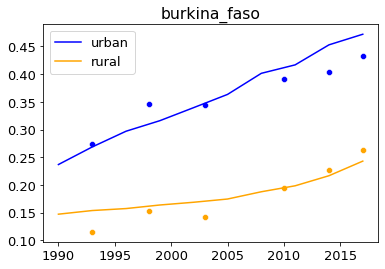

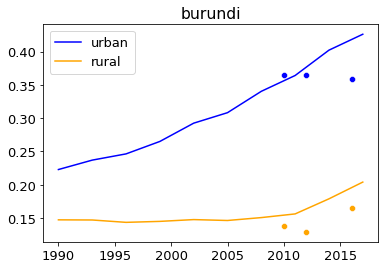

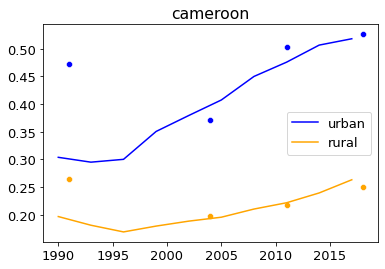

...

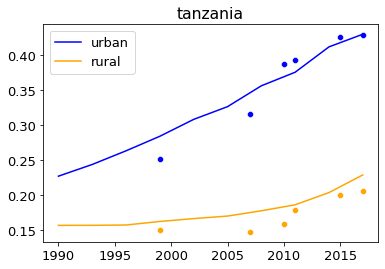

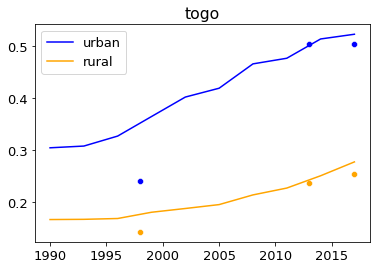

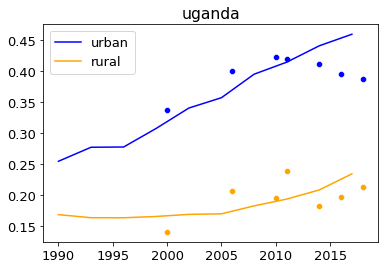

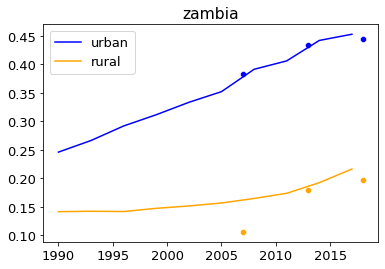

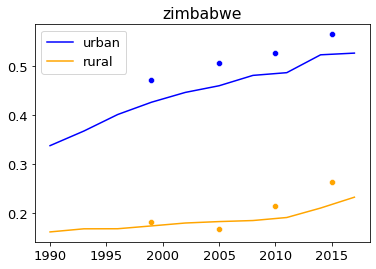

In [24]:
countries = df['country'].unique()
pred_columns = ['y_0', 'y_1', 'y_2', 'y_3', 'y_4', 'y_5', 'y_6', 'y_7', 'y_8', 'y_9']

for country in countries:
    country_df = df[df['country'] == country]
    country_years = country_df['survey_start_year'].unique()
    
    mean_urban = []
    mean_rural = []
    
    for year in country_years:
        cy_df = country_df[country_df['survey_start_year'] == year]
        mean_urban_iwi = cy_df[cy_df['rural'] == 0]['iwi'].mean()
        mean_rural_iwi = cy_df[cy_df['rural'] == 1]['iwi'].mean()
        mean_urban.append(mean_urban_iwi)
        mean_rural.append(mean_rural_iwi)
    
    years = list(range(1990, 2020, 3))
    urban_preds = country_df[country_df['rural'] == 0][pred_columns].mean()
    rural_preds = country_df[country_df['rural'] == 1][pred_columns].mean()
    sns.lineplot(x=years, y=urban_preds, color='blue', label='urban')
    sns.lineplot(x=years, y=rural_preds, color='orange', label='rural')
    sns.scatterplot(x=country_years, y=mean_urban, color='blue')
    sns.scatterplot(x=country_years, y=mean_rural, color='orange')
    plt.title(country)
    plt.show()

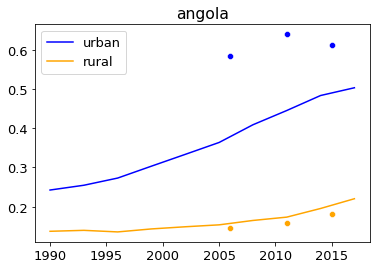

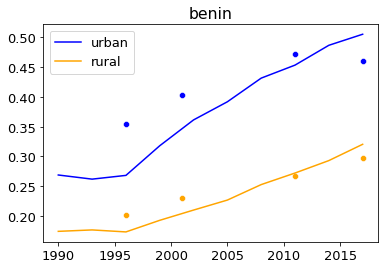

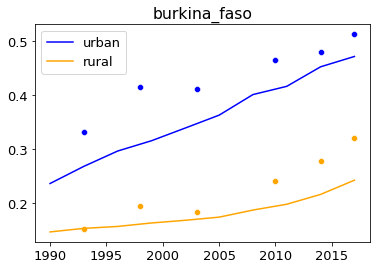

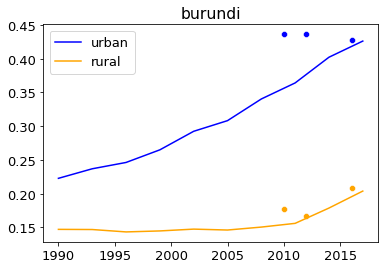

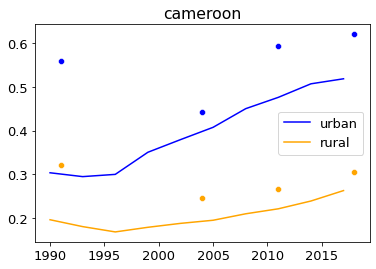

...

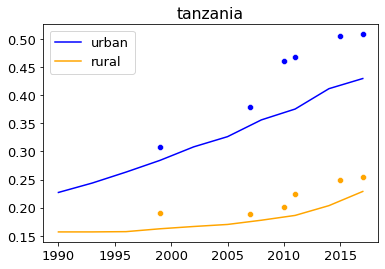

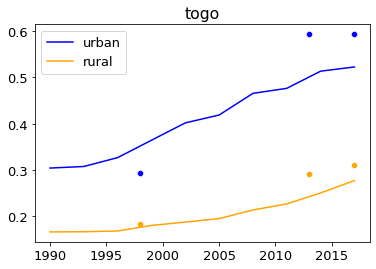

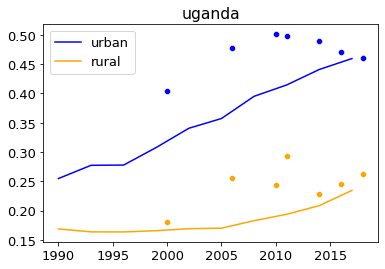

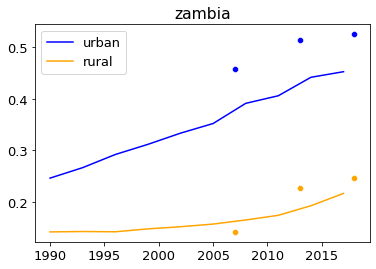

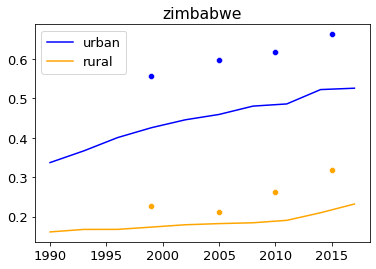

In [18]:
countries = df['country'].unique()
pred_columns = ['y_0', 'y_1', 'y_2', 'y_3', 'y_4', 'y_5', 'y_6', 'y_7', 'y_8', 'y_9']

for country in countries:
    country_df = df[df['country'] == country]
    country_years = country_df['survey_start_year'].unique()
    
    mean_urban = []
    mean_rural = []
    
    for year in country_years:
        cy_df = country_df[country_df['survey_start_year'] == year]
        mean_urban_iwi = cy_df[cy_df['rural'] == 0]['iwi'].mean()
        mean_rural_iwi = cy_df[cy_df['rural'] == 1]['iwi'].mean()
        mean_urban.append(mean_urban_iwi)
        mean_rural.append(mean_rural_iwi)
    
    years = list(range(1990, 2020, 3))
    urban_preds = country_df[country_df['rural'] == 0][pred_columns].mean()
    rural_preds = country_df[country_df['rural'] == 1][pred_columns].mean()
    sns.lineplot(x=years, y=urban_preds, color='blue', label='urban')
    sns.lineplot(x=years, y=rural_preds, color='orange', label='rural')
    sns.scatterplot(x=country_years, y=mean_urban, color='blue')
    sns.scatterplot(x=country_years, y=mean_rural, color='orange')
    plt.title(country)
    plt.show()

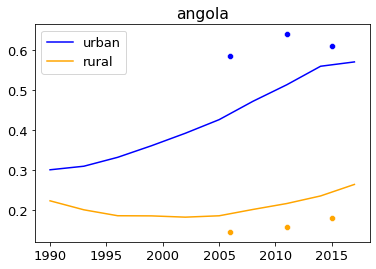

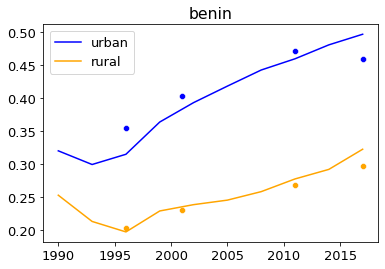

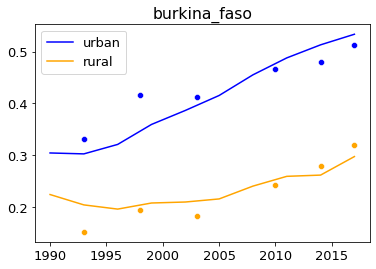

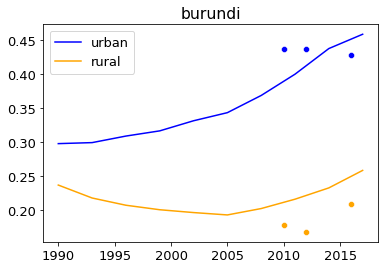

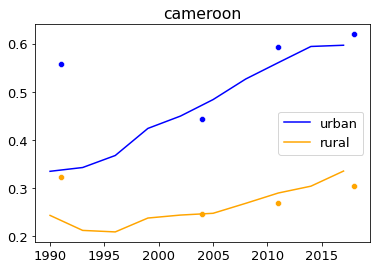

...

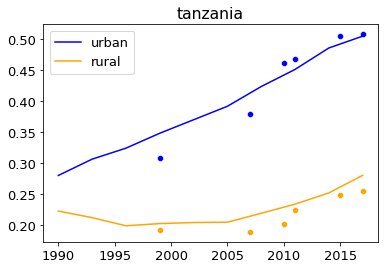

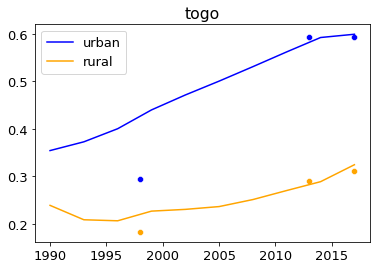

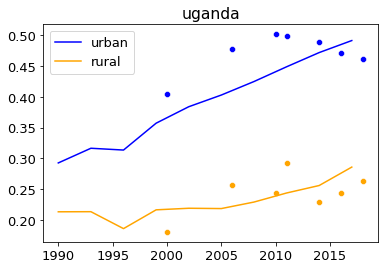

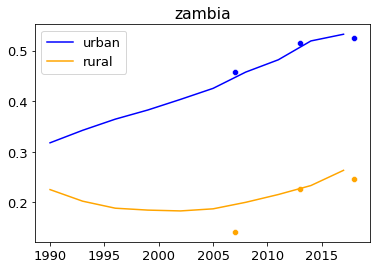

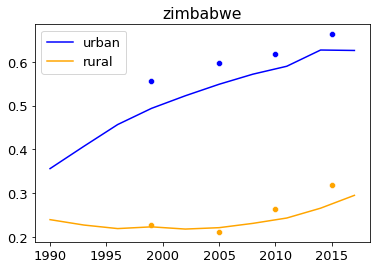

In [77]:
countries = df['country'].unique()

for country in countries:
    country_df = df[df['country'] == country]
    country_years = country_df['survey_start_year'].unique()
    
    mean_urban = []
    mean_rural = []
    
    for year in country_years:
        cy_df = country_df[country_df['survey_start_year'] == year]
        mean_urban_iwi = cy_df[cy_df['rural'] == 0]['iwi'].mean()
        mean_rural_iwi = cy_df[cy_df['rural'] == 1]['iwi'].mean()
        mean_urban.append(mean_urban_iwi)
        mean_rural.append(mean_rural_iwi)
    
    years = list(range(1990, 2020, 3))
    urban_preds = country_df[country_df['rural'] == 0][pred_columns].mean()
    rural_preds = country_df[country_df['rural'] == 1][pred_columns].mean()
    sns.lineplot(x=years, y=urban_preds, color='blue', label='urban')
    sns.lineplot(x=years, y=rural_preds, color='orange', label='rural')
    sns.scatterplot(x=country_years, y=mean_urban, color='blue')
    sns.scatterplot(x=country_years, y=mean_rural, color='orange')
    plt.title(country)
    plt.show()

In [89]:
df[df['country'] == 'malawi']['survey_start_year'].unique()

array([2000, 2004, 2010, 2012, 2014, 2015, 2016, 2017])

In [ ]:
countries = df['country'].unique()


for country in countries:
    country_years = df[df['country']== country]['year'].unique()
    index_list = []
    rural_iwis = []
    urban_iwis = []
    urban_index_list = []
    print(country_years)
    continue
    for year in country_years:
        country_year_df = country_year_df_total[(country_year_df_total['country'] == country) & (country_year_df_total['year'] == year)]
        urban_index_list.append(get_year_index(country_year_df.iloc[0,:]['year']))
        urban_iwis.append(country_year_df.iloc[0,:]['iwi'])
        if len(country_year_df) > 1:
            rural_iwis.append(country_year_df.iloc[1,:]['iwi'])
            index_list.append(get_year_index(country_year_df.iloc[1,:]['year']))

    plt.rcParams.update({'font.size': 11})
    plt.title(country)
    plt.xlabel('Year spans')
    plt.ylabel('Predicted IWI')
    c_df = country_urban_df[country_urban_df['country'] == country]
    plt.scatter(urban_index_list, urban_iwis)
    plt.scatter(index_list, rural_iwis)
    plt.plot(c_df[country_urban_df.columns[start_col:start_col+10]].iloc[0,:] , label='Urban')
    plt.plot(c_df[country_urban_df.columns[start_col:start_col+10]].iloc[1,:] , label='Rural')
    plt.scatter(c_df.iloc[0,:]['true_index'], c_df.iloc[0,:]['iwi'], marker='X', c='green')
    plt.scatter(c_df.iloc[1,:]['true_index'], c_df.iloc[1,:]['iwi'], marker='X', c='yellow')
    plt.legend()
    plt.rcParams.update({'font.size': 10})
    #ax.set_ylim([0,50])
    plt.xticks(country_urban_df[country_urban_df.columns[start_col:start_col+10]].columns, ['90-92', '93-95', '96-98', '99-01', '02-04', '05-07', '08-10', '11-13', '14-16', '17-19'])
    plt.show()
    plt.savefig('figures/' + f'{country}.png')

In [17]:
calc_score(df['iwi'], df['y_i'], 'r2', weights=df['households'])

0.7352912361758058

In [13]:
pd.read_csv('/mimer/NOBACKUP/groups/globalpoverty1/data/dhs_clusters.csv')

,country,survey_start_year,year,lat,lon,GID_1,GID_2,households,rural,iwi
0,angola,2006,2006,-12.169283,13.859255,AGO.2,AGO.2.9,20,0,68.096300
1,angola,2006,2006,-12.361700,14.778201,AGO.2,AGO.2.2,19,1,10.609053
2,angola,2006,2006,-10.827451,14.342114,AGO.7,AGO.7.1,25,1,29.973928
3,angola,2006,2006,-9.991311,14.898295,AGO.7,AGO.7.5,1,1,7.704135
4,angola,2006,2006,-11.518893,14.750437,AGO.7,AGO.7.10,24,1,13.371826
...,...,...,...,...,...,...,...,...,...,...
57190,zimbabwe,2015,2015,-20.911177,30.008579,ZWE.10,ZWE.10.6,28,1,27.791567
57191,zimbabwe,2015,2015,-20.402214,29.860028,ZWE.10,ZWE.10.8,28,1,36.929878
57192,zimbabwe,2015,2015,-20.724753,30.172833,ZWE.10,ZWE.10.6,27,1,24.406326
57193,zimbabwe,2015,2015,-19.453466,29.820084,ZWE.10,ZWE.10.4,28,0,59.887344
